In [1]:
# Import dependencies
%matplotlib inline
import os
import scanpy as sc
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import anndata

# Print date and time:
import datetime
e = datetime.datetime.now()
print ("Current date and time = %s" % e)

# set a working directory
wdir = "/Users/alinakurjan/Devel/scRNAseq in Python OBDS (10-14 Feb 2025)/Day 2 Quality Control/"
os.chdir( wdir )

# folder structures
RESULTS_FOLDERNAME = "QC/results/"
FIGURES_FOLDERNAME = "QC/figures/"

if not os.path.exists(RESULTS_FOLDERNAME):
    os.makedirs(RESULTS_FOLDERNAME)
if not os.path.exists(FIGURES_FOLDERNAME):
    os.makedirs(FIGURES_FOLDERNAME)

# Set folder for saving figures into
sc.settings.figdir = FIGURES_FOLDERNAME

# Set other settings
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions() # prints out the package versions - good for troubleshooting and reproducibility
sc.set_figure_params(dpi=150, fontsize=10, dpi_save=600) # sets figure saving parameters

Current date and time = 2025-02-07 12:20:35.295357
-----
anndata     0.11.3
scanpy      1.10.4
-----
Cython              3.0.11
PIL                 11.1.0
appnope             0.1.4
asttokens           NA
cloudpickle         3.1.1
colorama            0.4.6
comm                0.2.2
cycler              0.12.1
cython              3.0.11
cython_runtime      NA
dateutil            2.9.0.post0
debugpy             1.8.12
decorator           5.1.1
executing           2.1.0
h5py                3.12.1
igraph              0.11.8
ipykernel           6.29.5
ipywidgets          8.1.5
jedi                0.19.2
joblib              1.4.2
kiwisolver          1.4.8
legacy_api_wrap     NA
leidenalg           0.10.2
llvmlite            0.43.0
matplotlib          3.10.0
matplotlib_inline   0.1.7
mpl_toolkits        NA
natsort             8.4.0
numba               0.60.0
numpy               1.26.4
packaging           24.2
pandas              2.2.3
parso               0.8.4
patsy               1.0.1
picklesh

### Load CellBender-filtered files into a cb_dict dictionary object

In [2]:
cb_dict = {}
tdir = "/Users/alinakurjan/Devel/scRNAseq in Python OBDS (10-14 Feb 2025)/Teaching Data"
for folder in os.listdir(tdir):
    h5ad_path = os.path.join(tdir, folder, f'{folder}.h5ad') # note the use of f-string functionality in file naming.
    if os.path.exists(h5ad_path):
        adata = sc.read_h5ad(h5ad_path) # note a change in function here as we are working with h5ad files (more versatile)
        cb_dict[folder] = adata
cb_dict

{'CellRanger_DEV16569_Ach_Jan2023': AnnData object with n_obs × n_vars = 10887 × 36601
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
     var: 'gene_ids', 'feature_types', 'genome',
 'CellRanger_DEV16127_Quad_Jan2023': AnnData object with n_obs × n_vars = 13754 × 36601
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
     var: 'gene_ids', 'feature_types', 'genome',
 'CellRanger_DEV15984_Ach_Sep2022': AnnData object with n_obs × n_vars = 6173 × 36601
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
     var: 'gene_ids', 'feature_types', 'genome'}

In [3]:
def convert_uint_to_int(adata_dict):
    """
    Iterate over a dictionary of anndata objects and convert uint32 dtype
    to int32 dtype. Prints a message for each conversion.
    """
    for key, adata in adata_dict.items():   
        # Update X and layers dtypes
        if adata.X.dtype == 'uint32':
            adata.X = adata.X.astype('int32')
            print("Converted X from uint32 to int32.")
        else:
            pass

In [4]:
convert_uint_to_int(cb_dict)

Converted X from uint32 to int32.
Converted X from uint32 to int32.
Converted X from uint32 to int32.


### So how do you process dozens of files in parallel? Well, let's see:

1) You can process anndata object individually by referring to them within a dictionary, e.g. by modifying 'cb_dict['CellRanger_DEV16569_Ach_Jan2023']' inplace.
2) You can use for loops to iterate over each individual anndata object within the dictionary, applying the same function to all of them.

In [5]:
# If you are terrified of loops, try the following:
adata1 = cb_dict['CellRanger_DEV16569_Ach_Jan2023']
adata2 = cb_dict['CellRanger_DEV16127_Quad_Jan2023']
adata3 = cb_dict['CellRanger_DEV15984_Ach_Sep2022']

print(adata1)
print(adata2)
print(adata3)

### note that we are not copying them, but rather saving them as direct assignments 
### so that they can be modified in place within the original 'cb_dict' dictionary object

AnnData object with n_obs × n_vars = 10887 × 36601
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
    var: 'gene_ids', 'feature_types', 'genome'
AnnData object with n_obs × n_vars = 13754 × 36601
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
    var: 'gene_ids', 'feature_types', 'genome'
AnnData object with n_obs × n_vars = 6173 × 36601
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
    var: 'gene_ids', 'feature_types', 'genome'


In [6]:
# If you are not terrified of loops (and you should not be, they're awesome), your adata1 or adata2 or adata3 are simply adata, but after the following:
for key, adata in cb_dict.items():
    print(adata)

AnnData object with n_obs × n_vars = 10887 × 36601
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
    var: 'gene_ids', 'feature_types', 'genome'
AnnData object with n_obs × n_vars = 13754 × 36601
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
    var: 'gene_ids', 'feature_types', 'genome'
AnnData object with n_obs × n_vars = 6173 × 36601
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode'
    var: 'gene_ids', 'feature_types', 'genome'


### Feel free to try either of those approaches depending on how much time and confidence you have.

### 1) Using Scanpy functions, perform basic filtering on cb_dict anndata objects by filtering out 1) genes expressed in fewer than 5 cells, and 2) cells that express fewer than 200 genes. Print the name of the sample, the total number of genes and the total number of cells before and after filtering.

In [7]:
for key, adata in cb_dict.items():
    print(f"Sample: {key}")
    print(f"Genes before filtering: {adata.n_vars}")
    sc.pp.filter_genes(adata, min_cells=5, inplace=True) # removes genes expressed in fewer than 5 cells
    print(f"Genes after filtering: {adata.n_vars}")
    
    print()
    print(f"Cells before filtering: {adata.n_obs}")
    sc.pp.filter_cells(adata, min_genes=200, inplace=True) #removes cells expressing fewer than 200 genes
    print(f"Cells after filtering: {adata.n_obs}")
    print()

Sample: CellRanger_DEV16569_Ach_Jan2023
Genes before filtering: 36601
filtered out 12737 genes that are detected in less than 5 cells
Genes after filtering: 23864

Cells before filtering: 10887
filtered out 444 cells that have less than 200 genes expressed
Cells after filtering: 10443

Sample: CellRanger_DEV16127_Quad_Jan2023
Genes before filtering: 36601
filtered out 9646 genes that are detected in less than 5 cells
Genes after filtering: 26955

Cells before filtering: 13754
filtered out 1838 cells that have less than 200 genes expressed
Cells after filtering: 11916

Sample: CellRanger_DEV15984_Ach_Sep2022
Genes before filtering: 36601
filtered out 13047 genes that are detected in less than 5 cells
Genes after filtering: 23554

Cells before filtering: 6173
filtered out 290 cells that have less than 200 genes expressed
Cells after filtering: 5883



### 2) Check the top 20 highest expressed genes in the cellbender-filtered samples using all individual anndatas within the 'cb_dict' dictionary. What do you think about the identified genes?

normalizing counts per cell
    finished (0:00:00)


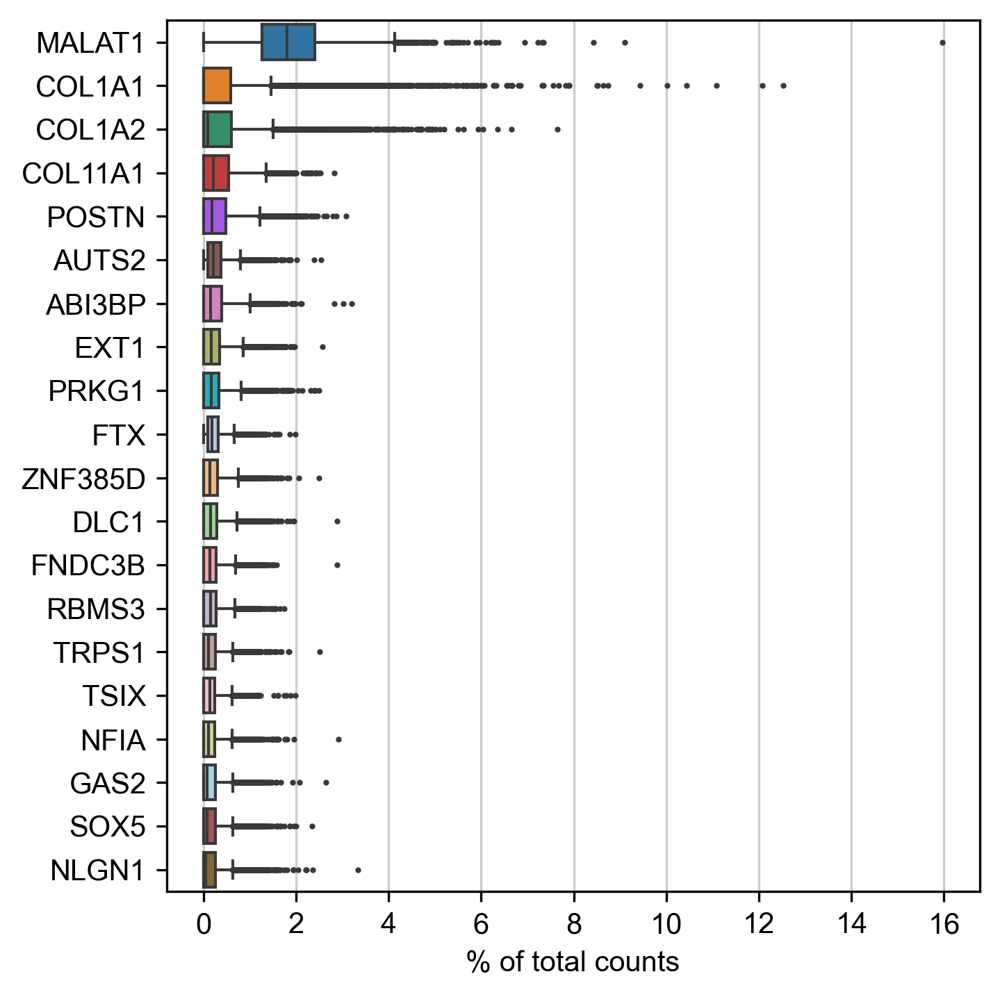

normalizing counts per cell
    finished (0:00:00)


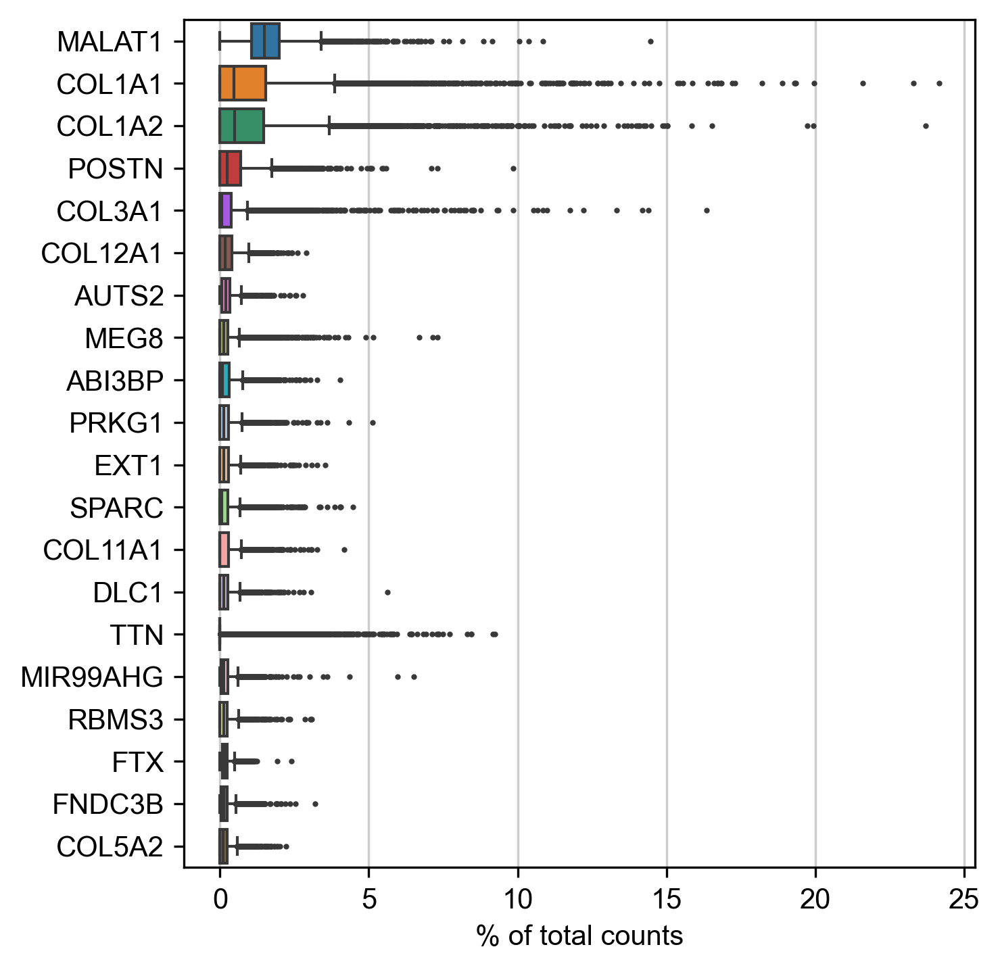

normalizing counts per cell
    finished (0:00:00)


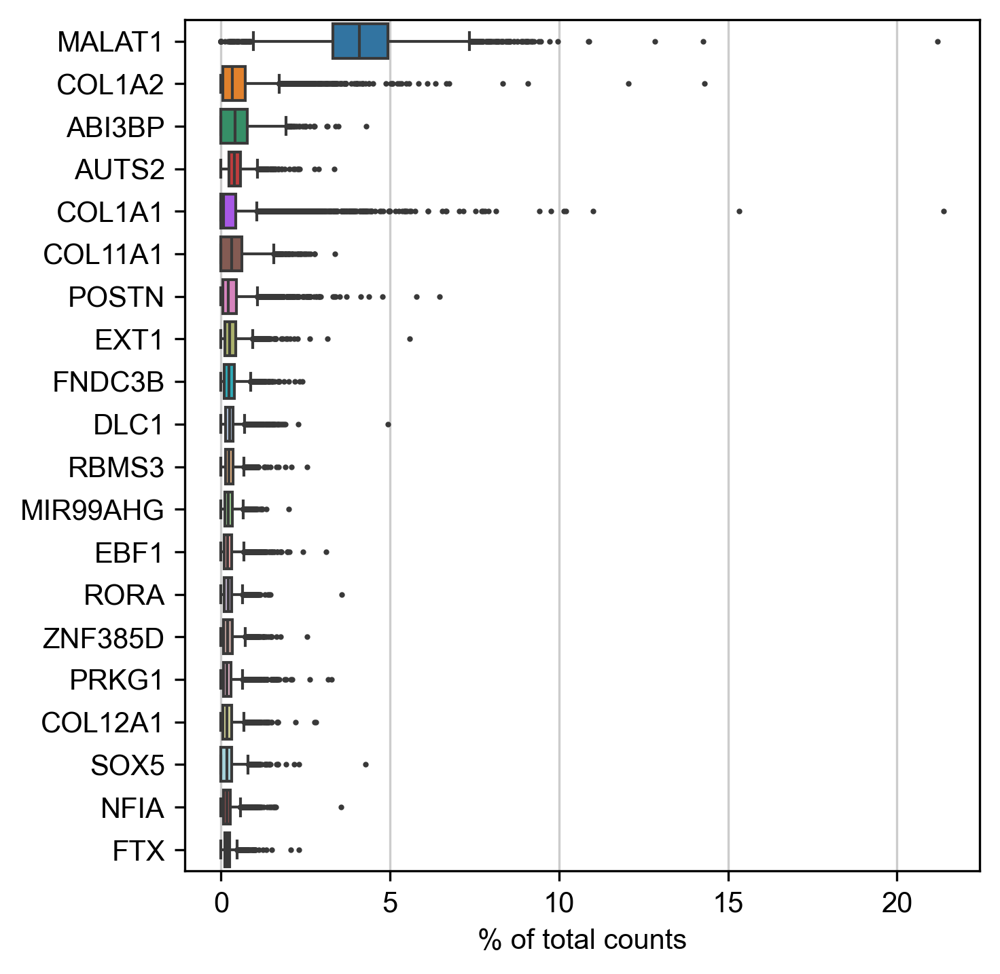

In [8]:
for adata in cb_dict.values():
    sc.pl.highest_expr_genes(adata, n_top=20)

### 4) Write code to exclude MALAT1 from vars. Check that it worked by printing out updated numbers of cells.

<details>
<summary>Click to reveal hint</summary>

_Look up scanpy data subsetting if not sure how to proceed. Gene symbol names are in adata.var_names in our case. If you had gene names in a different column in adata.var, then you'd use that column as adata.var[columnwithgenenames]_

</details>

In [9]:
for key, anndata in cb_dict.items():
    print(f'Before: {anndata.n_vars}')
    anndata = anndata[:, anndata.var_names != 'MALAT1']
    print(f'After: {anndata.n_vars}')
    cb_dict[key] = anndata               # write this back to update the dictionary

for key, anndata in cb_dict.items():
    if 'MALAT1' in anndata.var_names:
        print("MALAT1 is still present in var_names.")
    else:
        print("MALAT1 successfully removed from var_names.")

Before: 23864
After: 23863
Before: 26955
After: 26954
Before: 23554
After: 23553
MALAT1 successfully removed from var_names.
MALAT1 successfully removed from var_names.
MALAT1 successfully removed from var_names.


### Check the top 20 highest expressed genes again to make sure it worked

normalizing counts per cell
    finished (0:00:00)


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


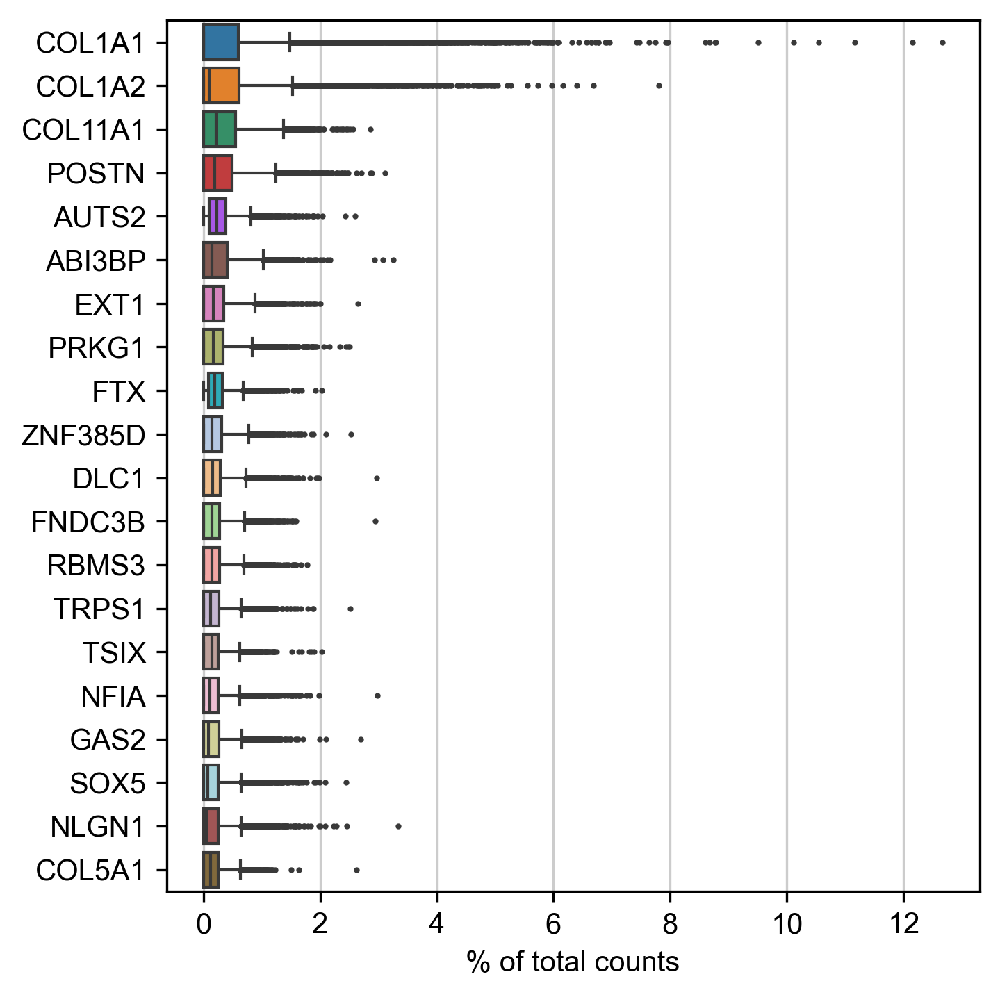

normalizing counts per cell
    finished (0:00:00)


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


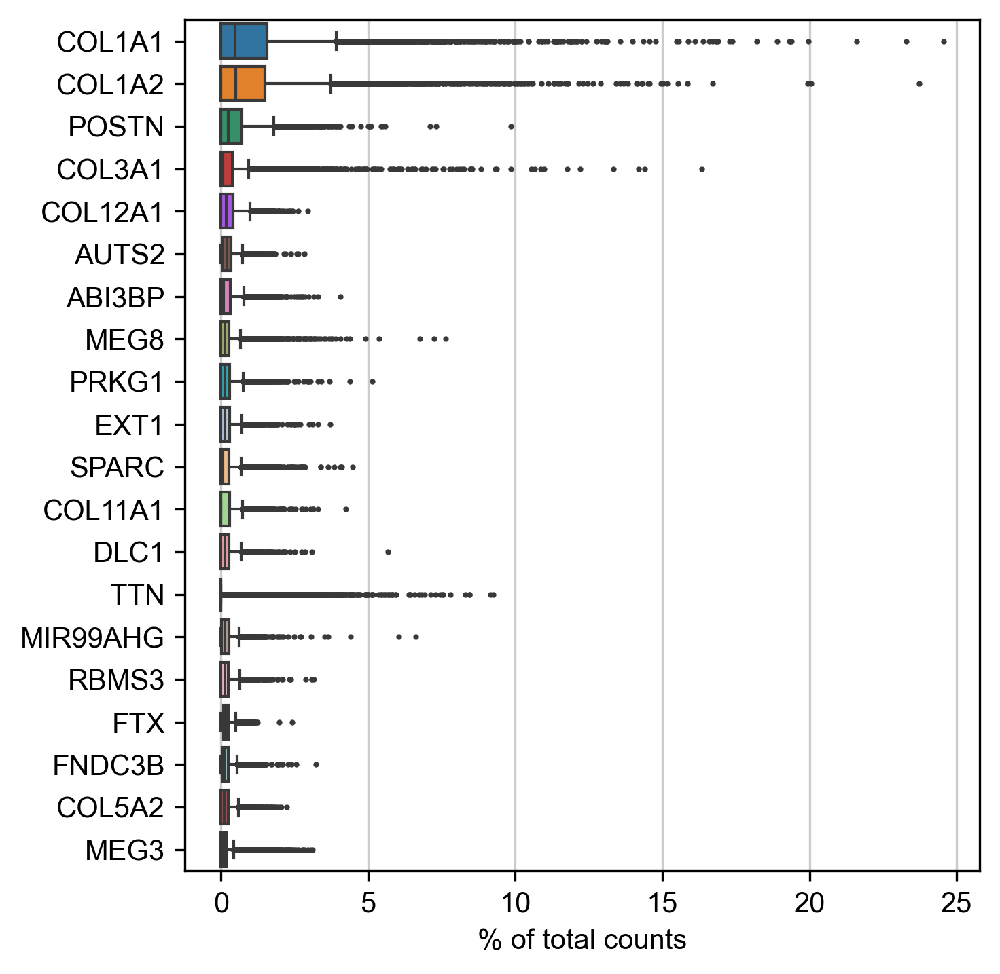

normalizing counts per cell
    finished (0:00:00)


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


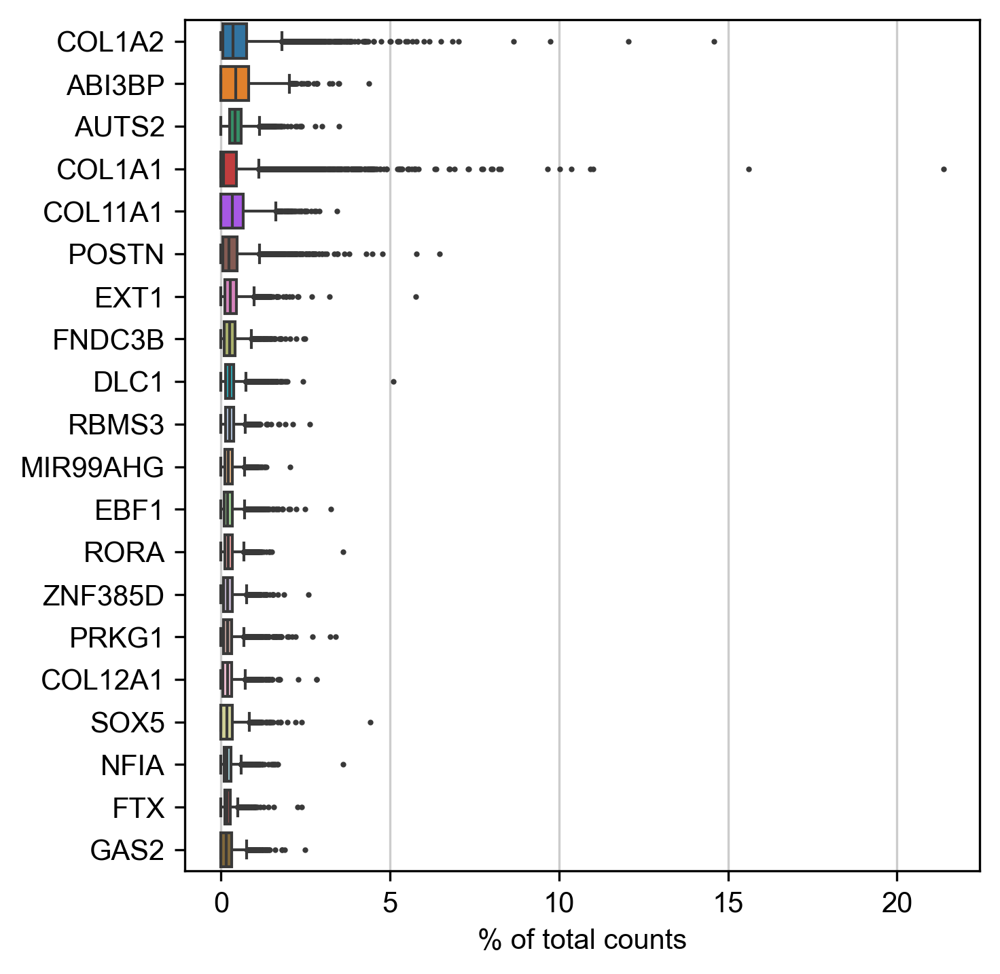

In [10]:
for adata in cb_dict.values():
    sc.pl.highest_expr_genes(adata, n_top=20)

### 5) Using Scanpy's pp.calculate_qc_metrics() function, generate the basic QC metrics for your anndatas. Make sure to include log1p modification and to calculate the % of counts within the top 20 and 500 highest expressed genes. Plot the violin and scatter plots of QC metrics. Save the files with sample names.

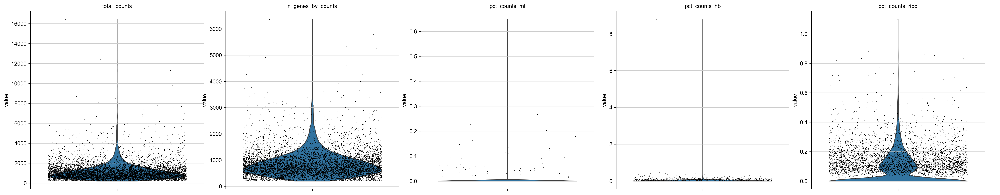

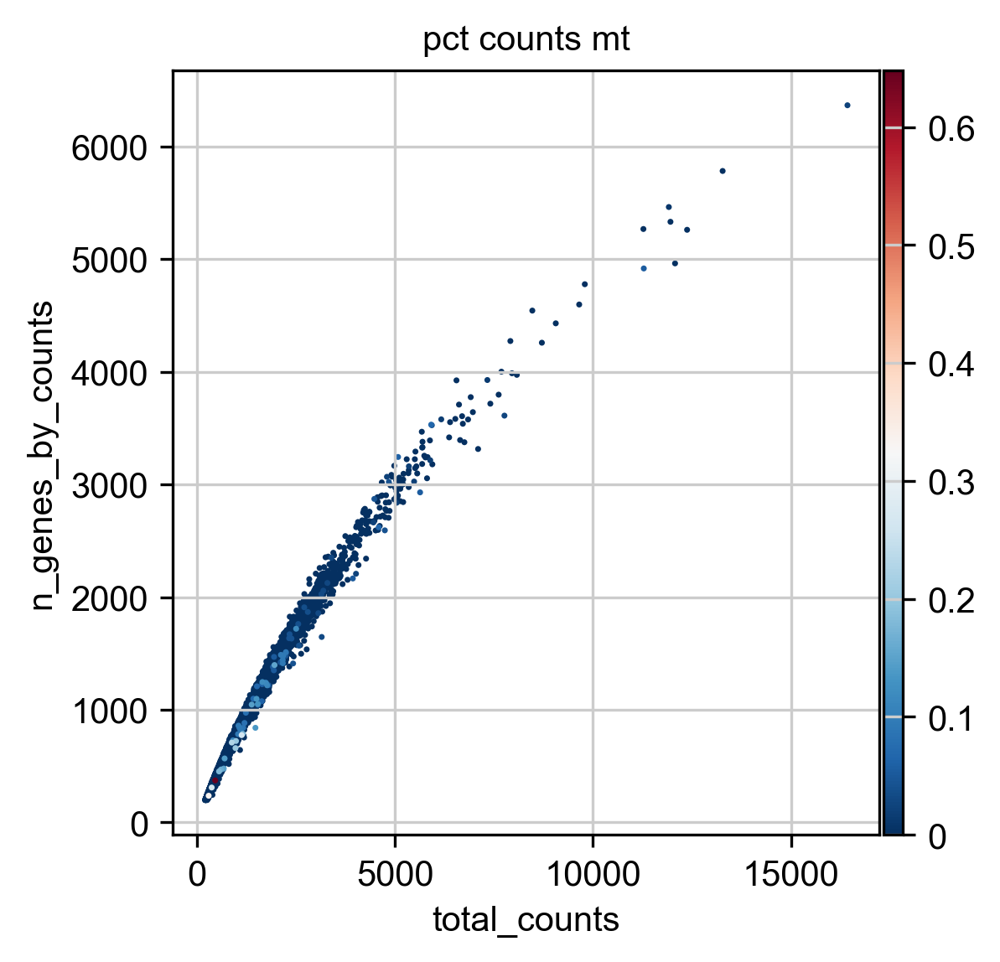

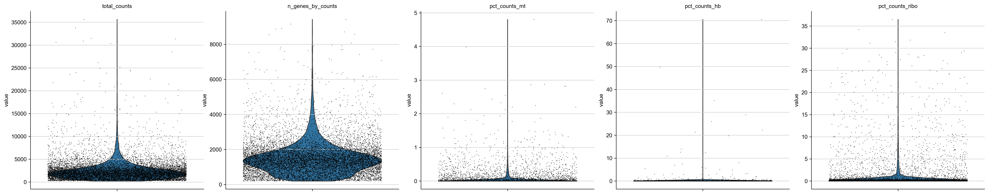

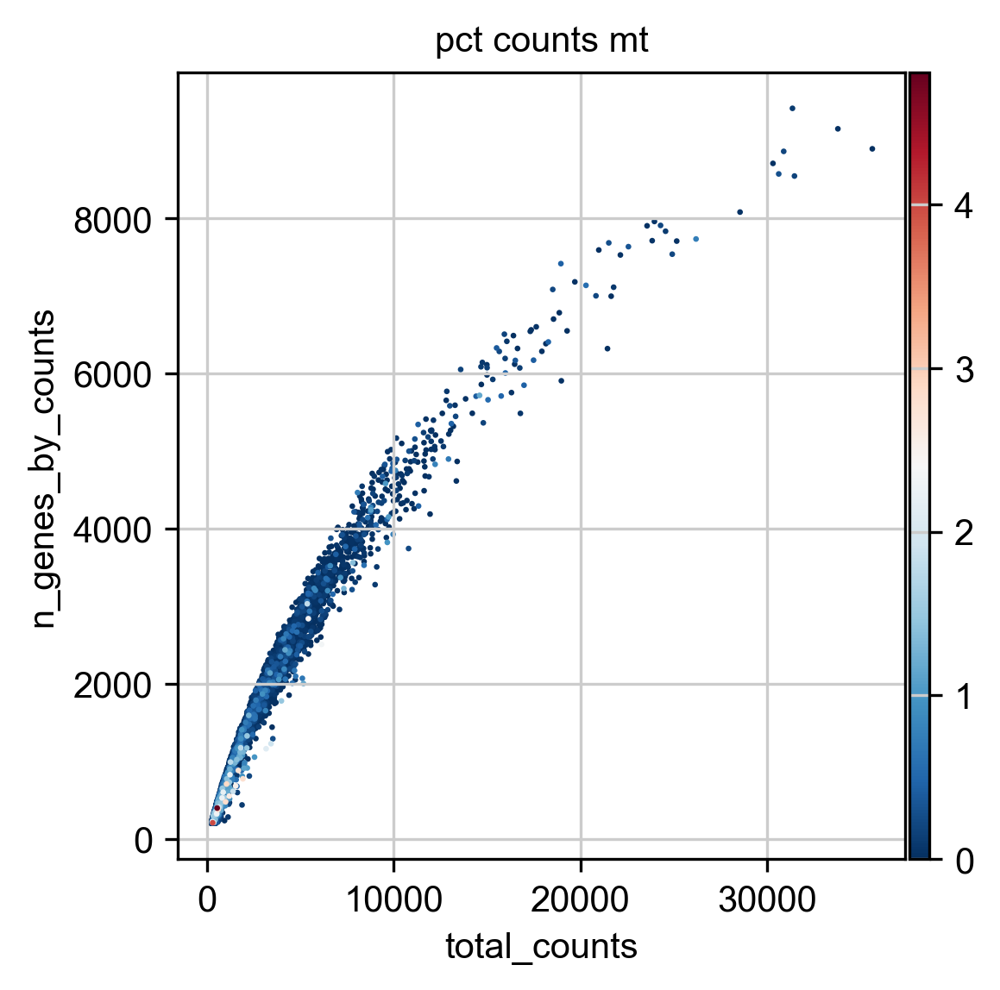

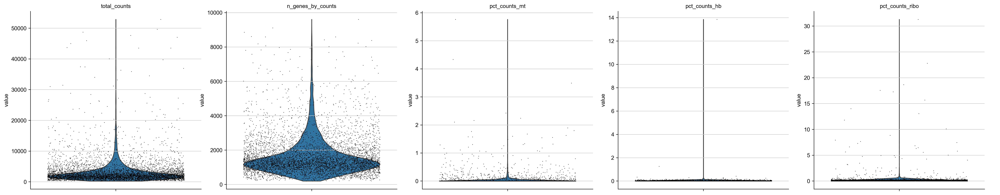

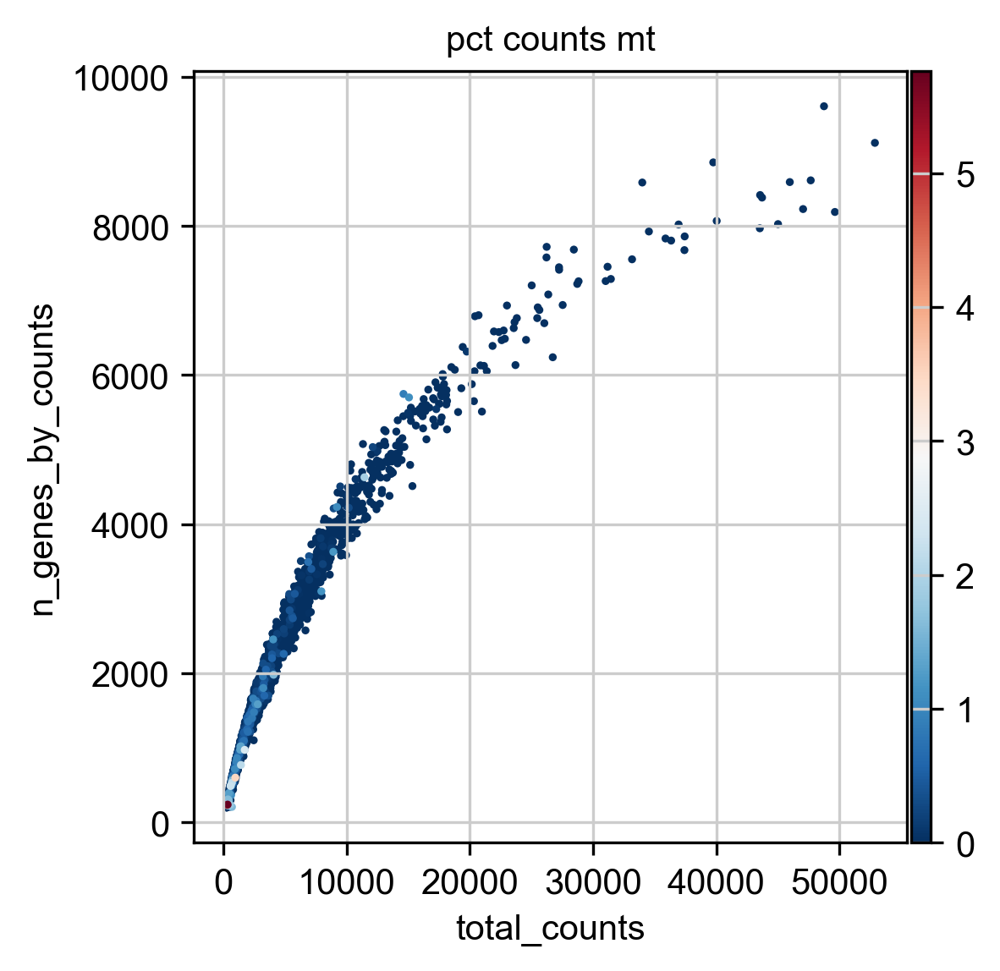

In [11]:
for samplename, adata in cb_dict.items():
    adata.var.index.name = 'Gene'
    adata.var["mt"] = adata.var.index.str.startswith("MT-") 
    adata.var["ribo"] = adata.var.index.str.startswith(("RPS", "RPL"))
    adata.var["hb"] = adata.var.index.str.contains(("^HB[^(P)]"))
    
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=[20, 500], log1p=True)

    sc.pl.violin(
        adata, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_hb', 'pct_counts_ribo'], 
        show=True, jitter=0.4, multi_panel=True, save=f'_{samplename}_cellbender_original.svg'
    )

    sc.pl.scatter(
        adata, "total_counts", "n_genes_by_counts", color='pct_counts_mt', 
        color_map='RdBu_r', # you can use the cmap/color_map parameter to change the colour map (matplotlib); setting _r at the end of any colourmap reverses the order of colours!
        save=f'_{samplename}_cellbender_unfiltered.svg'
    )

In [12]:
# this function makes a single plot for all samples:
def QC_plots(adata_dict, features, filename):
    n_features = len(features)
    fig, axes = plt.subplots(len(adata_dict), n_features, figsize=(15, 3 * len(adata_dict)))
    
    for i, (adata_name, adata) in enumerate(adata_dict.items()):
        row_title = f'{adata_name}'
        for j, feature in enumerate(features):
            ax = axes[i, j]
            sc.pl.violin(adata, feature, ax=ax, show=False, jitter=0.4)
        axes[i, 0].set_ylabel(row_title, fontsize=10)
    
    fig.tight_layout()
    fig.savefig(os.path.join(FIGURES_FOLDERNAME, filename), bbox_inches='tight')
    plt.show(fig)

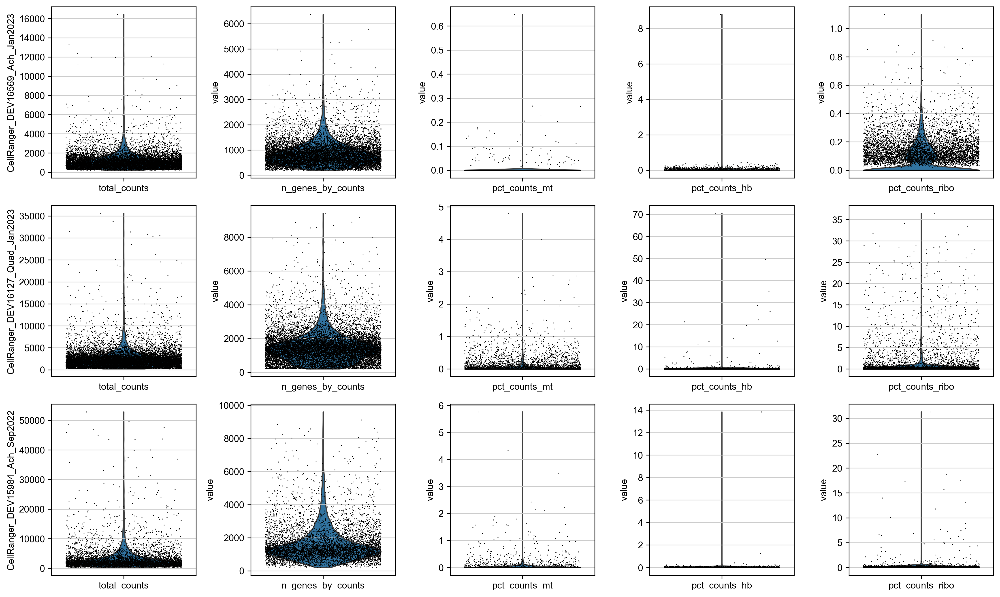

In [13]:
QC_plots(cb_dict, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_hb', 'pct_counts_ribo'],
         'QC_cellbender_unfiltered.png')

### 6) For each anndata object within the cb_dict dictionary, save adata.X into a new 'counts' layer. Make adata.var_names unique.

In [14]:
for adata in cb_dict.values():
    adata.layers['counts'] = adata.X.copy()
    adata.var_names_make_unique()
cb_dict

{'CellRanger_DEV16569_Ach_Jan2023': AnnData object with n_obs × n_vars = 10443 × 23863
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
     layers: 'counts',
 'CellRanger_DEV16127_Quad_Jan2023': AnnData object with n_obs × n_vars = 11916 × 26954
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct

### 7) The functions below have been adapted from the sc-best-practices resource to carry out MAD-based filtering of anndatas contained within a given dictionary. Describe how they work (you may want to annotate the code).

Code for MAD calculations adapted from:
https://www.sc-best-practices.org/preprocessing_visualization/quality_control.html:

In [15]:
def is_outlier(adata, metric: str, nmads: int):
    M = adata.obs[metric]
    #outlier = (M < np.median(M) - nmads * M.mad()) | (
    #    np.median(M) + nmads * M.mad() < M
    #)
    
    ##if the above returns an Attribute Error relating to M.mad(), this is due to the pandas package version.
    # Run this instead using np.median and np.median absolute deviation (mad) from numpy
    outlier = (M < np.median(M) - nmads * np.median(np.abs(M - np.median(M)))) | (
        np.median(M) + nmads * np.median(np.abs(M - np.median(M))) < M
    )
    return outlier

def outlier_check(adata_dict):
    for key, adata in adata_dict.items():
        adata.obs["outlier"] = (is_outlier(adata, "log1p_total_counts", 5)
                                | is_outlier(adata, "log1p_n_genes_by_counts", 5)
                                | is_outlier(adata, "pct_counts_in_top_20_genes", 5))
        print(f"5 MAD Count outliers in {key}") 
        print(str(adata.obs.outlier.value_counts()))
        print()
    
        adata.obs["mt_outlier"] = is_outlier(adata, "pct_counts_mt", 3) | (adata.obs["pct_counts_mt"] > 10)
        print(f"3 MAD or 8% Mito outliers in {key}") 
        print(str(adata.obs.mt_outlier.value_counts()))
        print()
        
def outlier_removal(adata_dict):
    outlier_check(adata_dict)
    filtered_adatafiles = {}
    for key, adata in adata_dict.items():
        print(f"Total number of cells in {key}: {adata.n_obs}")
        adata = adata[(~adata.obs.outlier) & (~adata.obs.mt_outlier)].copy()
        print(f"Number of cells after filtering of low quality cells: {adata.n_obs}")
        filtered_adatafiles[key] = adata.copy()
    return filtered_adatafiles

The is_outlier function is configured to detect outliers based on a specified number of median absolute deviations (MADs) from the median. Specifically, the outlier_check function applies this outlier detection to three metrics—log1p_total_counts, log1p_n_genes_by_counts, and pct_counts_in_top_20_genes—using a threshold of 5 MADs. Additionally, mitochondrial percentage (pct_counts_mt) is evaluated for outliers with a threshold of 3 MADs or if it exceeds 5%. The function prints the count of outliers for each metric. The subsequent outlier_removal function employs the outlier information to filter out identified cells with low-quality metrics, excluding both overall outliers and those specifically related to mitochondrial content. The total number of cells before and after filtering is printed, and the filtered AnnData objects are returned in a dictionary.

### Using the provided outlier_removal() function, generate a new 'filtered_adata_dict' object from 'cb_dict'. Check that it was generated correctly.

In [16]:
filtered_adata_dict = outlier_removal(cb_dict)
filtered_adata_dict

5 MAD Count outliers in CellRanger_DEV16569_Ach_Jan2023
outlier
False    10114
True       329
Name: count, dtype: int64

3 MAD or 8% Mito outliers in CellRanger_DEV16569_Ach_Jan2023
mt_outlier
False    10357
True        86
Name: count, dtype: int64

5 MAD Count outliers in CellRanger_DEV16127_Quad_Jan2023
outlier
False    11254
True       662
Name: count, dtype: int64

3 MAD or 8% Mito outliers in CellRanger_DEV16127_Quad_Jan2023
mt_outlier
False    9923
True     1993
Name: count, dtype: int64

5 MAD Count outliers in CellRanger_DEV15984_Ach_Sep2022
outlier
False    5664
True      219
Name: count, dtype: int64

3 MAD or 8% Mito outliers in CellRanger_DEV15984_Ach_Sep2022
mt_outlier
False    5339
True      544
Name: count, dtype: int64

Total number of cells in CellRanger_DEV16569_Ach_Jan2023: 10443
Number of cells after filtering of low quality cells: 10040
Total number of cells in CellRanger_DEV16127_Quad_Jan2023: 11916
Number of cells after filtering of low quality cells: 9490
Total 

{'CellRanger_DEV16569_Ach_Jan2023': AnnData object with n_obs × n_vars = 10040 × 23863
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
     layers: 'counts',
 'CellRanger_DEV16127_Quad_Jan2023': AnnData object with n_obs × n_vars = 9490 × 26954
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'l

### 8) Re-run the violin and scatter QC plots and save them as new, filtered figures.

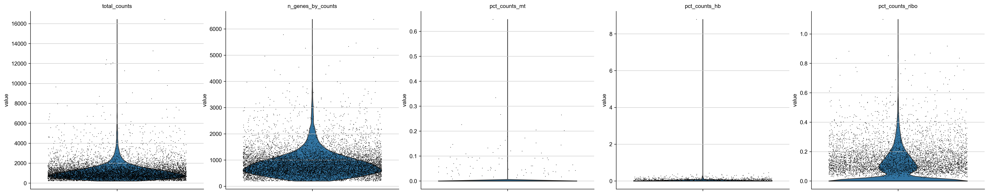

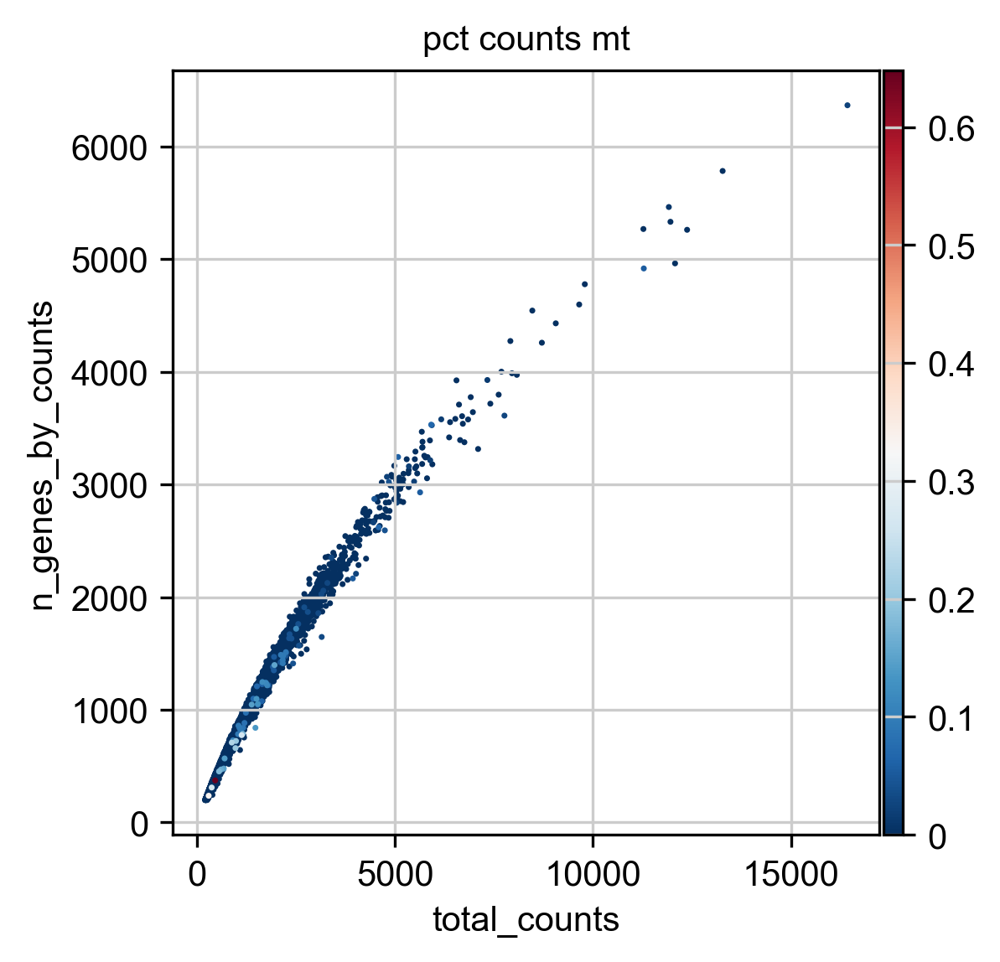

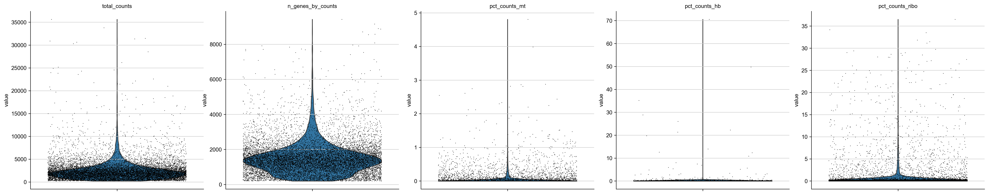

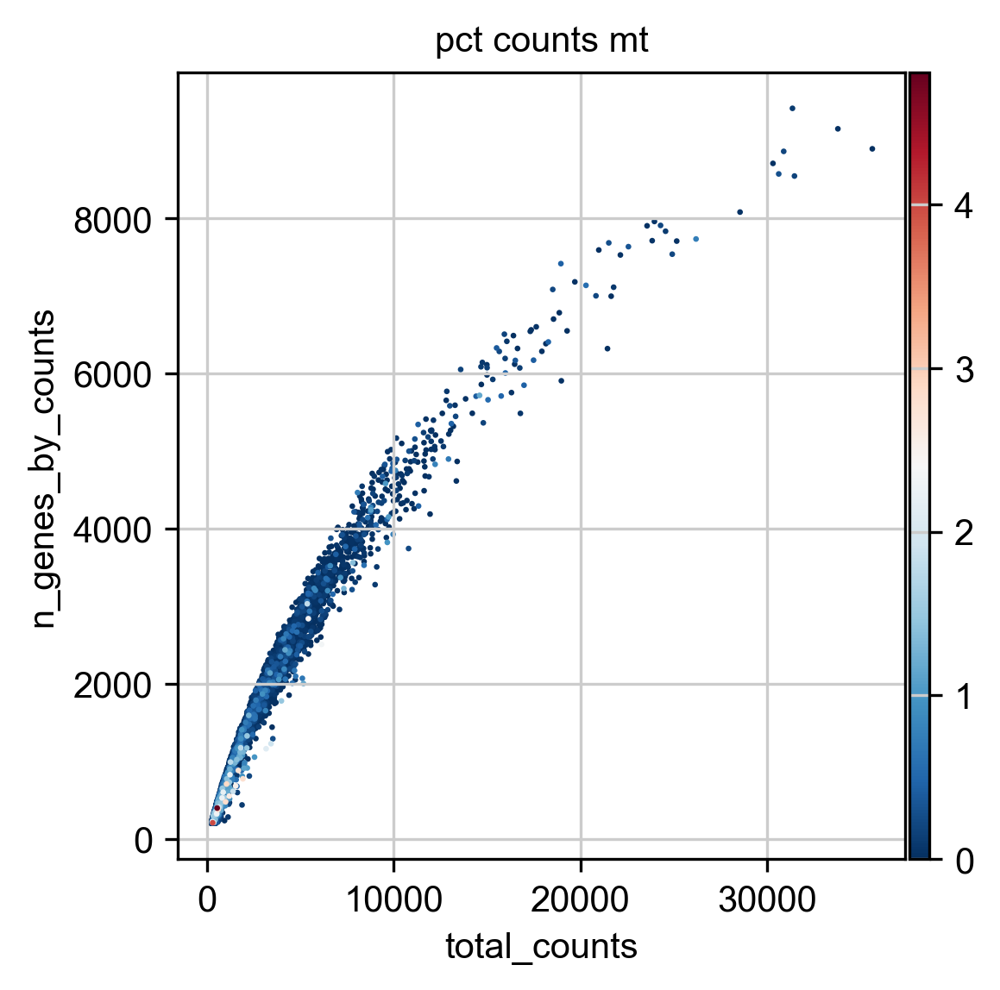

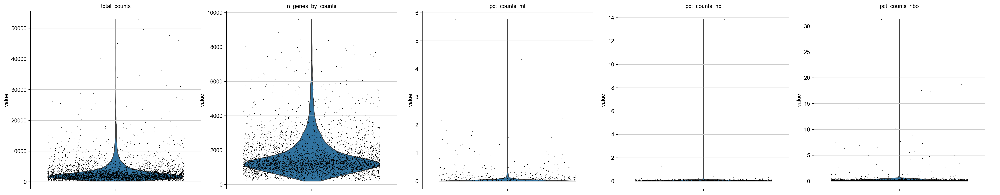

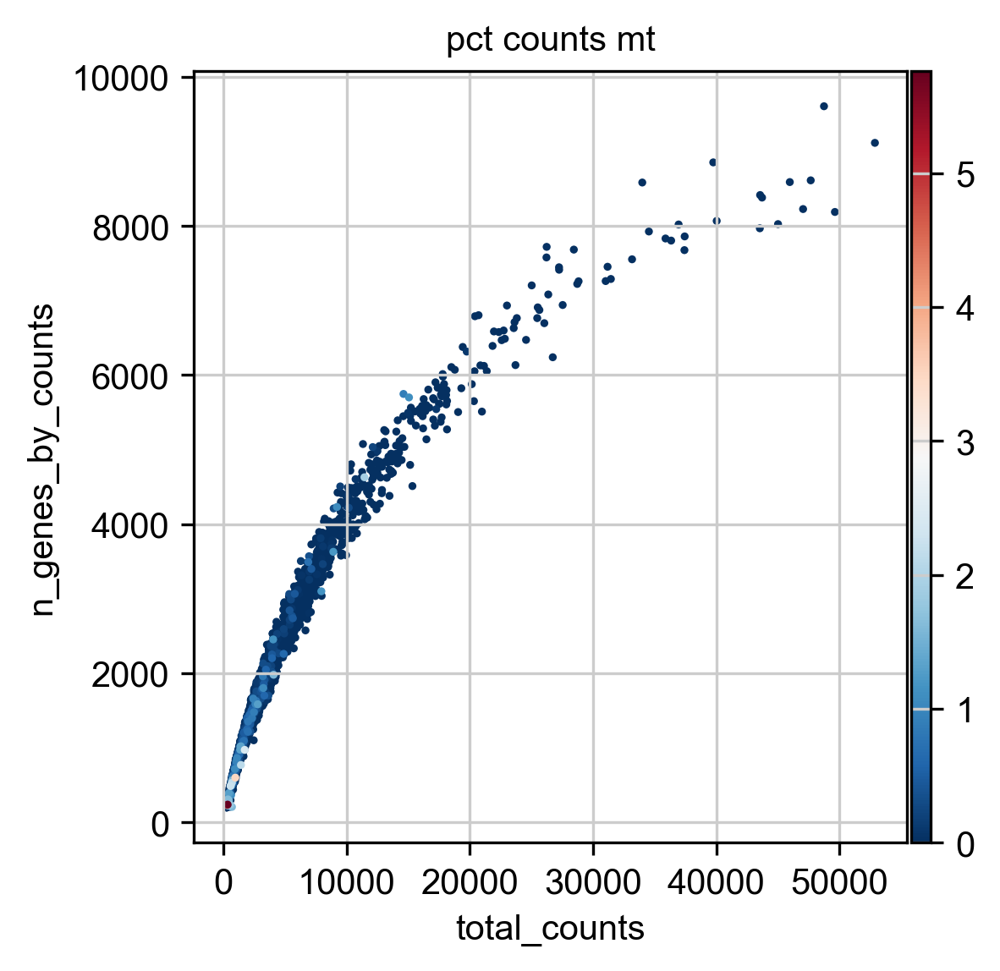

In [17]:
for samplename, adata in cb_dict.items():
    sc.pl.violin(
        adata, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_hb', 'pct_counts_ribo'], 
        show=True, jitter=0.4, multi_panel=True, save=f'_{samplename}_cellbender_filtered.svg'
    )

    sc.pl.scatter(
        adata, "total_counts", "n_genes_by_counts", color='pct_counts_mt', 
        color_map='RdBu_r',
        save=f'_{samplename}_cellbender_filtered.svg'
    )

While I would say that MAD filtering removal did a good job and there is no real need to filter further, there may be times when you'd like to apply further filters to individual samples. So let's say we want to filter the samples further using manual thresholds. We will focus specifically on the second and third samples in the dictionary as they could potentially benefit from removing samples with lower UMI and gene counts.

P.S. Do NOT set upper limit thresholds for counts or such at this stage as we will need these to identify potential doublets/multiplets later. 

### 9) Filter the anndata objects within cb_dict as follows: 
- first and second anndata objects to have haemoglobin gene counts lower than 2%.
- second anndata object ('CellRanger_DEV16127_Quad_Jan2023') to retain only the number of genes by counts above 400 and ribosomal counts of fewer than 2%.
- third anndata object to have more than 400 UMIs.

In [18]:
# to print out sample names
[key for key in filtered_adata_dict]

['CellRanger_DEV16569_Ach_Jan2023',
 'CellRanger_DEV16127_Quad_Jan2023',
 'CellRanger_DEV15984_Ach_Sep2022']

In [19]:
# Access the first AnnData object
adata_first = filtered_adata_dict["CellRanger_DEV16569_Ach_Jan2023"]
print(f"Original: {adata_first.n_obs}")

# Filter cells based on haemoglobin counts
adata_first_filtered = adata_first[adata_first.obs["pct_counts_hb"] < 2].copy()
print(f"Filtered number of cells with haemoglobin < 2% in the first sample: {adata_first_filtered.n_obs}")

# Update the dictionary with the filtered object
filtered_adata_dict["CellRanger_DEV16569_Ach_Jan2023"] = adata_first_filtered

Original: 10040
Filtered number of cells with haemoglobin < 2% in the first sample: 10039


In [20]:
adata_second = filtered_adata_dict["CellRanger_DEV16127_Quad_Jan2023"]
print(f"Original: {adata_second.n_obs}")

adata_second_filtered = adata_second[
    (adata_second.obs["n_genes_by_counts"] > 400) & 
    (adata_second.obs["pct_counts_ribo"] < 2)
].copy()
print(f"Filtered number of cells with genes > 400 and ribosomal < 2% in the second sample: {adata_second_filtered.n_obs}")

filtered_adata_dict["CellRanger_DEV16127_Quad_Jan2023"] = adata_second_filtered

Original: 9490
Filtered number of cells with genes > 400 and ribosomal < 2% in the second sample: 9064


In [21]:
adata_third = filtered_adata_dict["CellRanger_DEV15984_Ach_Sep2022"]
print(f"Original: {adata_third.n_obs}")

# Filter cells based on total UMI count
adata_third_filtered = adata_third[adata_third.obs["total_counts"] > 400].copy()
print(f"Filtered number of cells with total counts > 400 in the third sample: {adata_third_filtered.n_obs}")

filtered_adata_dict["CellRanger_DEV15984_Ach_Sep2022"] = adata_third_filtered

Original: 5177
Filtered number of cells with total counts > 400 in the third sample: 5148


### Re-run the violin and scatter QC plots and save them as new figures yet again. This is good practice to monitor your QC steps.

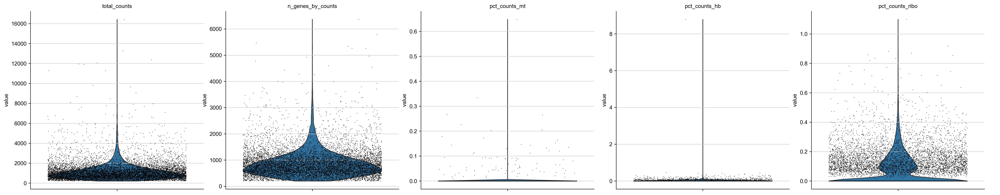

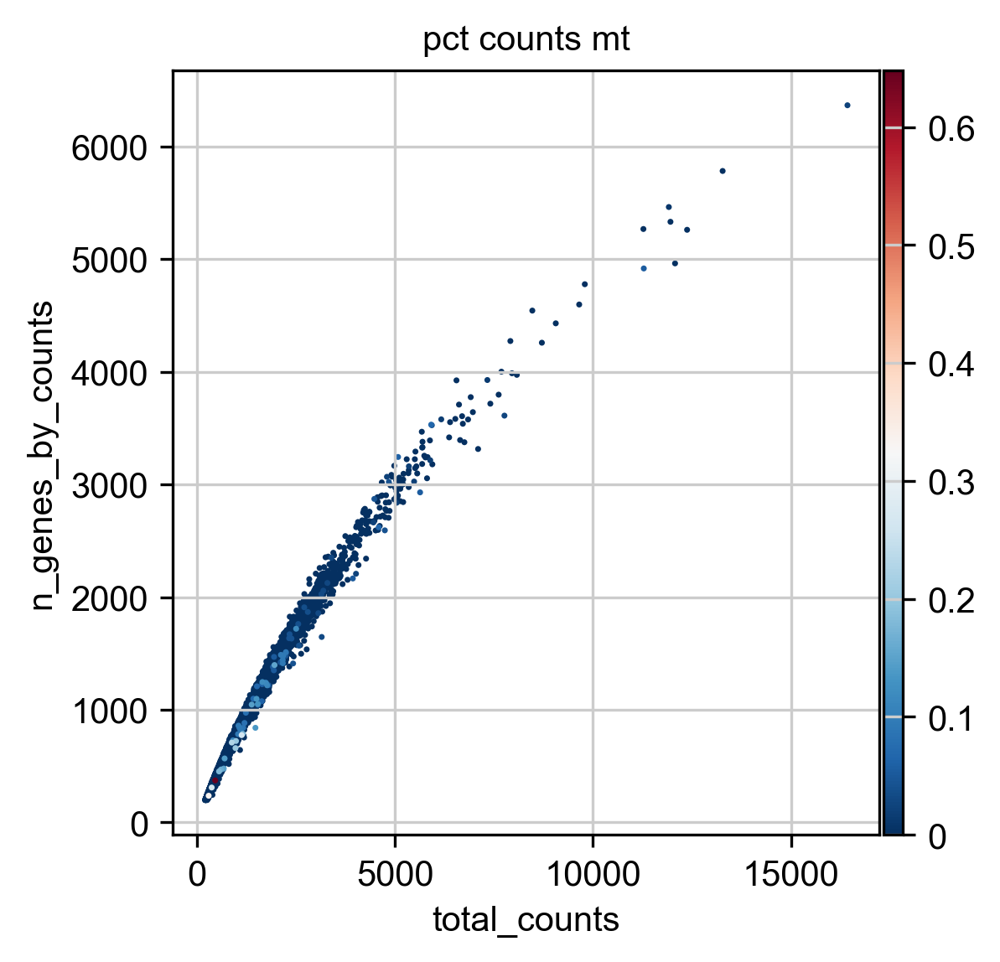

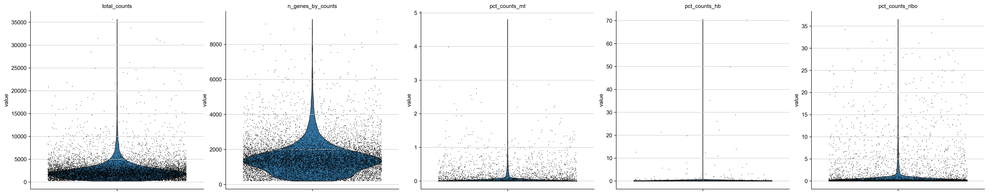

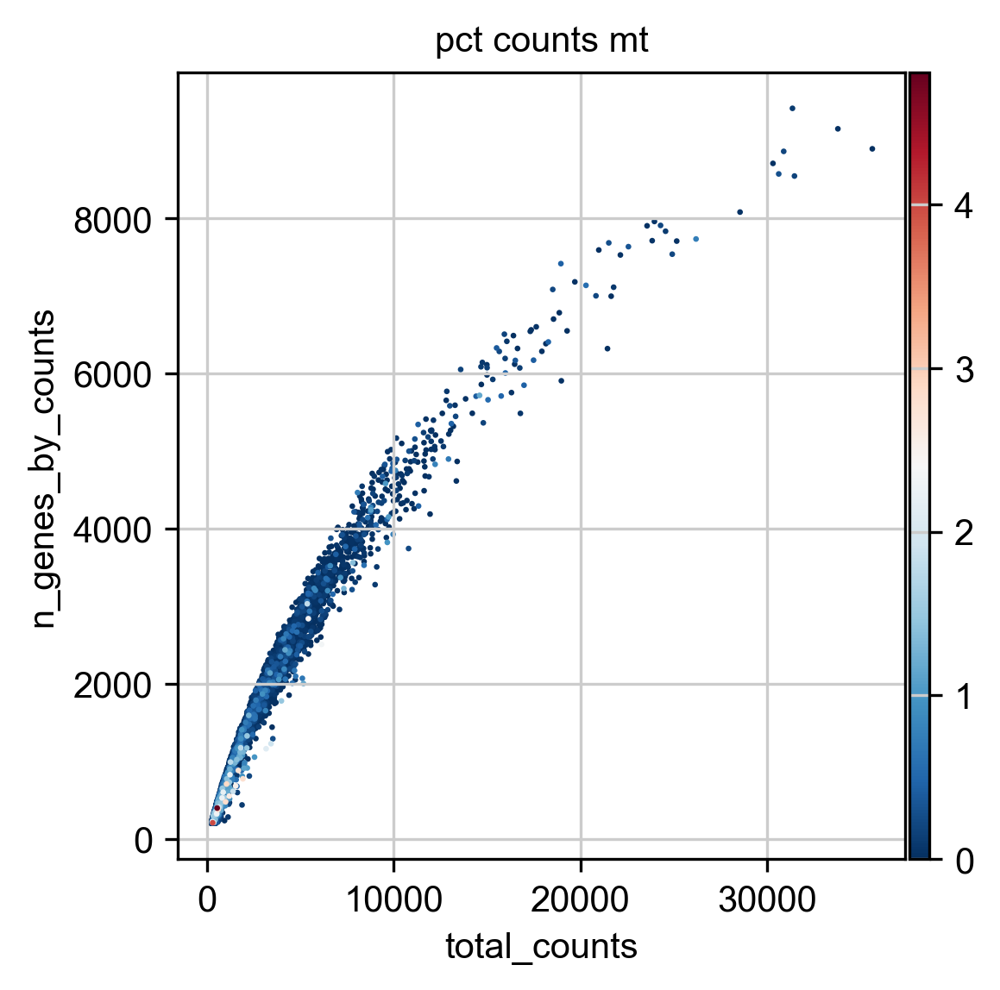

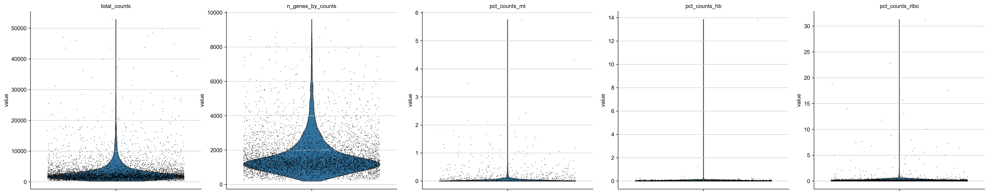

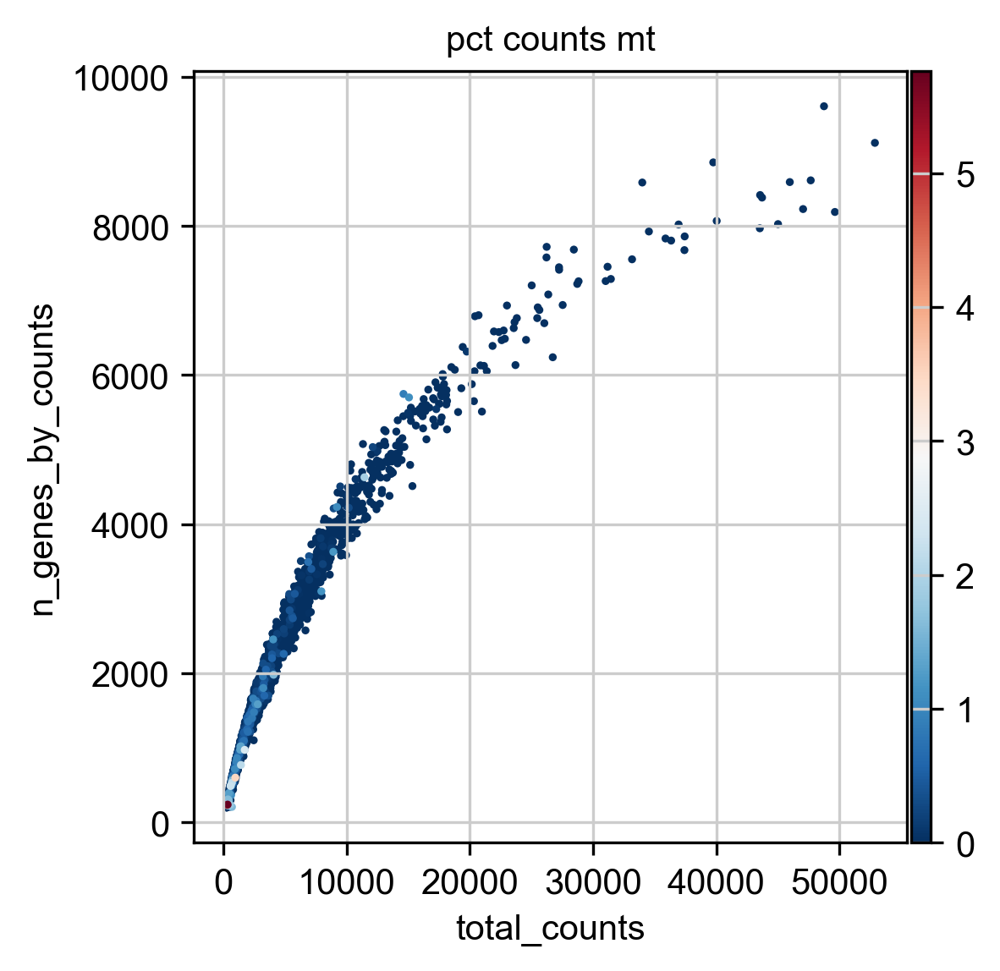

In [22]:
for samplename, adata in cb_dict.items():
    sc.pl.violin(
        adata, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_hb', 'pct_counts_ribo'], 
        show=True, jitter=0.4, multi_panel=True, save=f'_{samplename}_cellbender_filtered2.svg'
    )

    sc.pl.scatter(
        adata, "total_counts", "n_genes_by_counts", color='pct_counts_mt', 
        color_map='RdBu_r', # you can use the cmap/color_map parameter to change the colour map (matplotlib); setting _r at the end of any colourmap reverses the order of colours!
        save=f'_{samplename}_cellbender_filtered2.svg'
    )

### 10) Run the following code to remove doublets using Scanpy's Scrublet wrapper and generate histograms of observed vs simulated transcriptomes.

- https://scanpy.readthedocs.io/en/stable/api/generated/scanpy.pp.scrublet.html
- https://github.com/swolock/scrublet/blob/master/examples/scrublet_basics.ipynb - tutorial for the original Scrublet package

Recommendations by creators of Scrublet: When working with data from multiple samples, run Scrublet on each sample separately. Because Scrublet is designed to detect technical doublets formed by the random co-encapsulation of two cells, it may perform poorly on merged datasets where the cell type proportions are not representative of any single sample.
Check that the doublet score threshold is reasonable (in an ideal case, separating the two peaks of a bimodal simulated doublet score histogram, as in this example), and adjust manually if necessary.
Visualize the doublet predictions in a 2-D embedding (e.g., UMAP or t-SNE). Predicted doublets should mostly co-localize (possibly in multiple clusters). If they do not, you may need to adjust the doublet score threshold, or change the pre-processing parameters to better resolve the cell states present in your data.

Running Scrublet
filtered out 29 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%
    Scrublet finished (0:01:51)


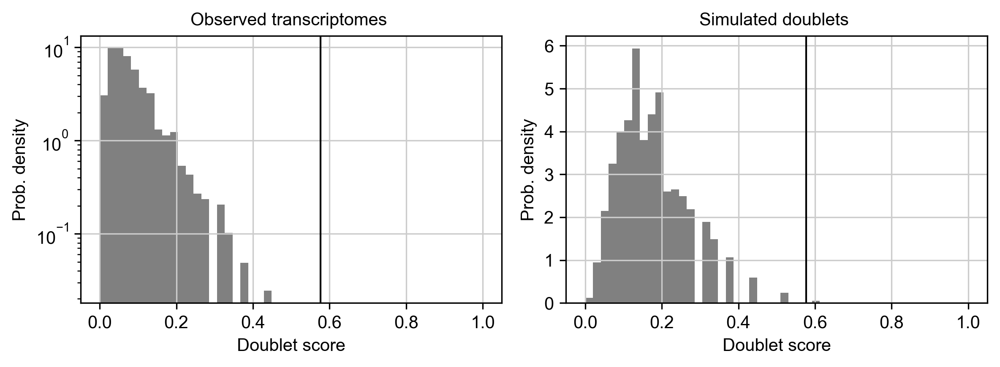

Running Scrublet
filtered out 276 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 2.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.3%
    Scrublet finished (0:01:24)


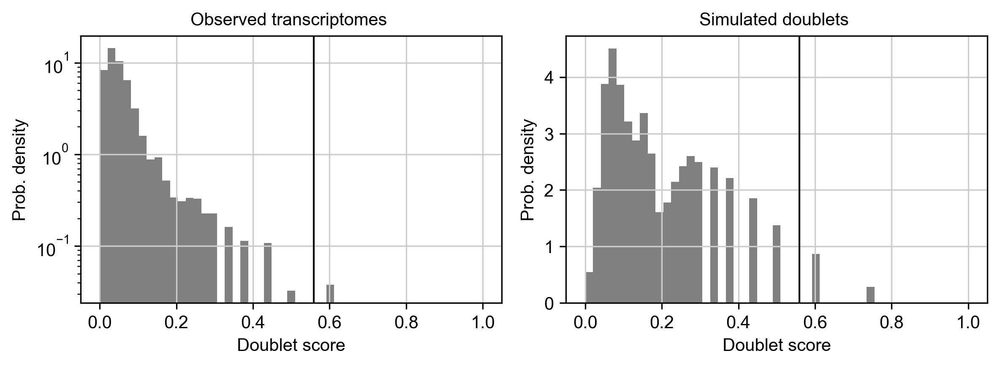

Running Scrublet
filtered out 322 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Automatically set threshold at doublet score = 0.30
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 68.2%
    Scrublet finished (0:00:36)


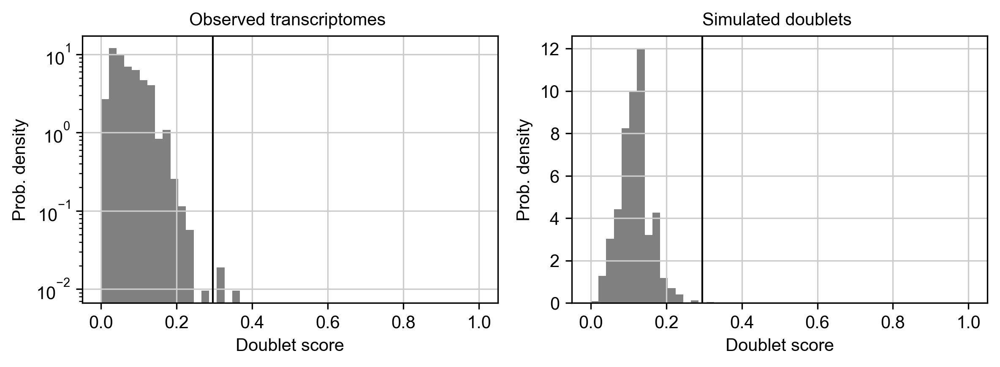

In [23]:
for adata in filtered_adata_dict.values():
    # In 10X Chromium seq, the rate of doublets expected for ~10,000 cells loaded into the well is about 5%. 
    # The higher the number of simulated doublet ratios, the more computationally intensive the calculation, but also the more likely we are to find the multiplets, to an extent.
    sc.pp.scrublet(adata, expected_doublet_rate = 0.05, sim_doublet_ratio = 5)
    sc.pl.scrublet_score_distribution(adata)

In [24]:
filtered_adata_dict['CellRanger_DEV16127_Quad_Jan2023'].obs[['doublet_score', 'predicted_doublet']]

,doublet_score,predicted_doublet
GAAGAATAGCTCTGTA.DEV16127_Quad,0.210725,False
GGCTGTGCAACCGACC.DEV16127_Quad,0.092999,False
TTTGTTGTCTAGCCAA.DEV16127_Quad,0.044954,False
CGAATTGGTGTGCTTA.DEV16127_Quad,0.124424,False
CTTGAGAGTTTCACTT.DEV16127_Quad,0.026007,False
...,...,...
TCGTGCTGTCTCAAGT.DEV16127_Quad,0.020514,False
TCTATCAAGTGGACTG.DEV16127_Quad,0.137235,False
CTCAAGAGTCGCTTGG.DEV16127_Quad,0.010705,False
GTAGATCGTGACCGTC.DEV16127_Quad,0.024758,False


### Do you agree with the automatic doublet thresholds used by Scrublet? If not, re-run the function with custom thresholds set for each of the anndata objects using the following function: - make sure you understand how it works and what it does. If not, please ask! :)

Processing CellRanger_DEV16569_Ach_Jan2023 (Object 1)
Running Scrublet
filtered out 29 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Detected doublet rate = 5.0%
Estimated detectable doublet fraction = 35.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 13.9%
    Scrublet finished (0:00:43)


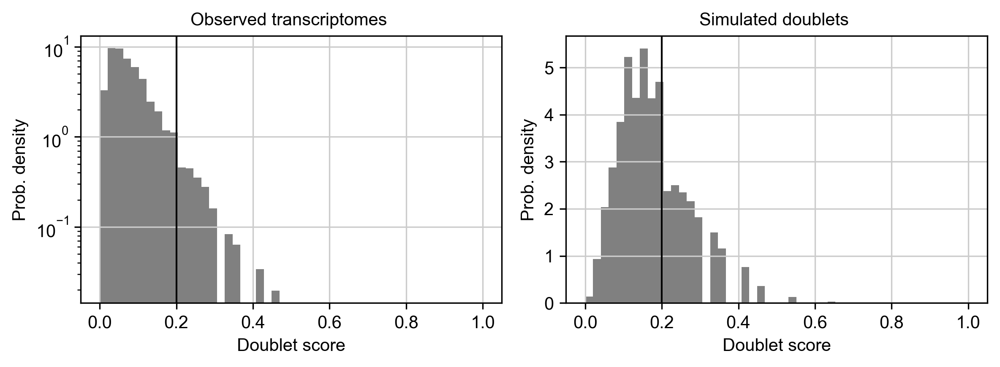

Processing CellRanger_DEV16127_Quad_Jan2023 (Object 2)
Running Scrublet
filtered out 276 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Detected doublet rate = 4.0%
Estimated detectable doublet fraction = 41.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 9.6%
    Scrublet finished (0:00:33)


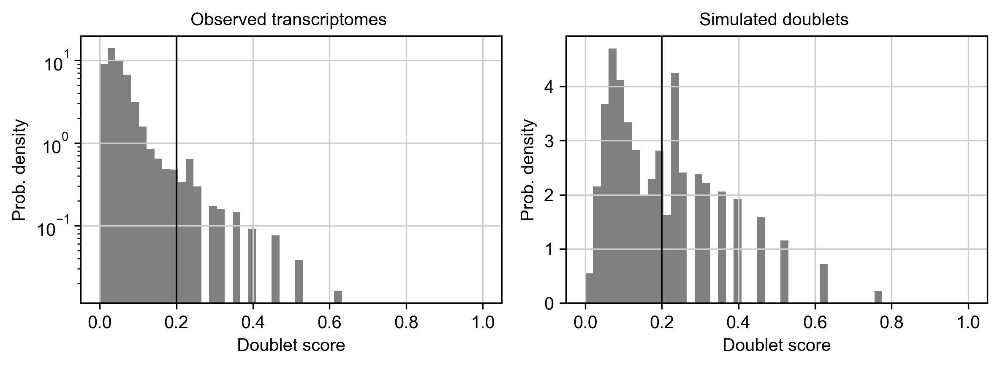

Processing CellRanger_DEV15984_Ach_Sep2022 (Object 3)
Running Scrublet
filtered out 322 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 21.7%
    Scrublet finished (0:00:16)


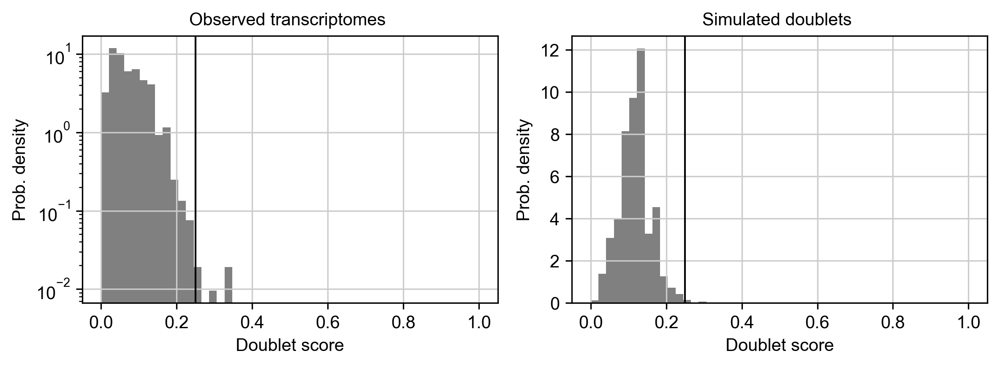

In [25]:
for i, (key, adata) in enumerate(filtered_adata_dict.items()):
    print(f"Processing {key} (Object {i+1})")

    if i == 0:
        sc.pp.scrublet(adata, expected_doublet_rate = 0.05, sim_doublet_ratio = 3, threshold=0.2)
        sc.pl.scrublet_score_distribution(adata)
    elif i == 1:
        sc.pp.scrublet(adata, expected_doublet_rate = 0.05, sim_doublet_ratio = 3, threshold=0.2)
        sc.pl.scrublet_score_distribution(adata)
    elif i == 2:
        sc.pp.scrublet(adata, expected_doublet_rate = 0.05, sim_doublet_ratio = 3, threshold=0.25)
        sc.pl.scrublet_score_distribution(adata)
    else:
        print('yo smth not right man')

### Check the identified doublet distribution across data clusters using UMAPs - we will discuss this in detail later.

In [26]:
# Function to process and visualize an Anndata object
def process_and_visualize(adata):
    adata.obs['predicted_doublet'] = adata.obs['predicted_doublet'].astype("category")
    adata.layers['counts'] = adata.X.copy()
    
    # log1pPF normalise data:
    sc.pp.normalize_total(adata, target_sum=None, inplace=True)
    sc.pp.log1p(adata)
    
    # select highly variable genes:
    sc.pp.highly_variable_genes(adata, n_top_genes= 2500, flavor='cell_ranger')
    
    # scale gene expression:
    sc.pp.scale(adata)
    
    # reduce dimensionality:
    sc.pp.pca(adata, use_highly_variable=True, n_comps=30, svd_solver="arpack")
    sc.pp.neighbors(adata, n_neighbors=20)
    sc.tl.umap(adata)

In [27]:
for key, adata in filtered_adata_dict.items():
    process_and_visualize(adata)

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=30


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:03)
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=30


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:06)
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=30


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:03)


In [28]:
# check how the counts have been modified after normalisation and scaling:
for adata in filtered_adata_dict.values():
    print(adata.layers['counts'][0:5, 0:5])
    print()
    print(adata.X[0:5,0:5])
    print()

<Compressed Sparse Row sparse matrix of dtype 'int32'
	with 2 stored elements and shape (5, 5)>
  Coords	Values
  (1, 3)	1
  (4, 4)	1

[[-0.02836935 -0.04718596 -0.03130108 -0.0373402  -0.22857214]
 [-0.02836935 -0.04718596 -0.03130108  5.07319843 -0.22857214]
 [-0.02836935 -0.04718596 -0.03130108 -0.0373402  -0.22857214]
 [-0.02836935 -0.04718596 -0.03130108 -0.0373402  -0.22857214]
 [-0.02836935 -0.04718596 -0.03130108 -0.0373402   0.60762244]]

<Compressed Sparse Row sparse matrix of dtype 'int32'
	with 4 stored elements and shape (5, 5)>
  Coords	Values
  (0, 3)	1
  (2, 3)	1
  (3, 3)	2
  (4, 0)	1

[[-0.0367617  -0.05644417 -0.03003351  0.22465488 -0.02636519]
 [-0.0367617  -0.05644417 -0.03003351 -0.33546652 -0.02636519]
 [-0.0367617  -0.05644417 -0.03003351  0.36145502 -0.02636519]
 [-0.0367617  -0.05644417 -0.03003351  0.90453844 -0.02636519]
 [ 6.29168094 -0.05644417 -0.03003351 -0.33546652 -0.02636519]]

<Compressed Sparse Row sparse matrix of dtype 'int32'
	with 3 stored eleme

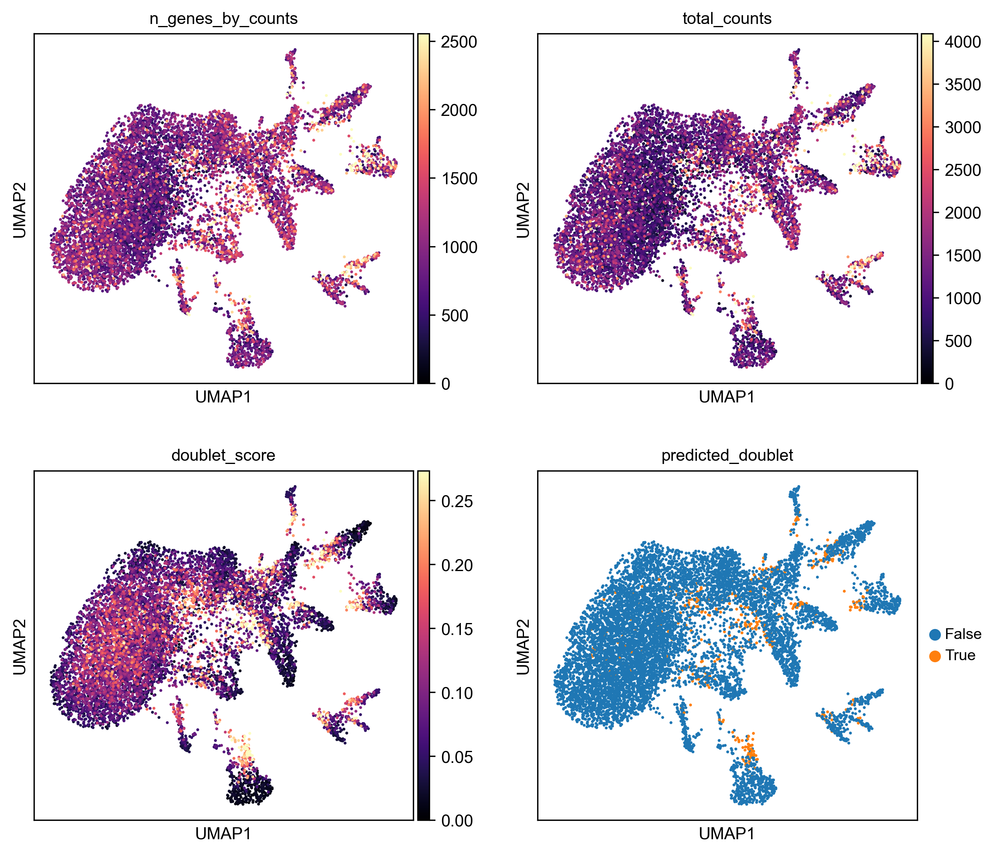

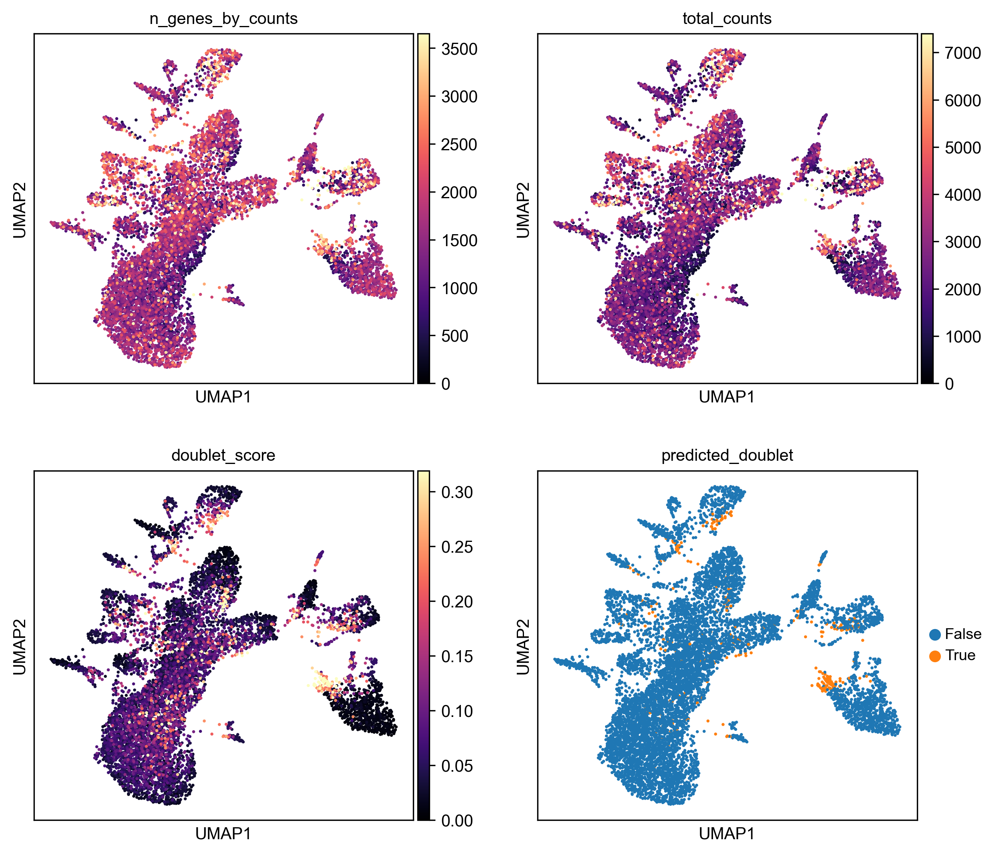

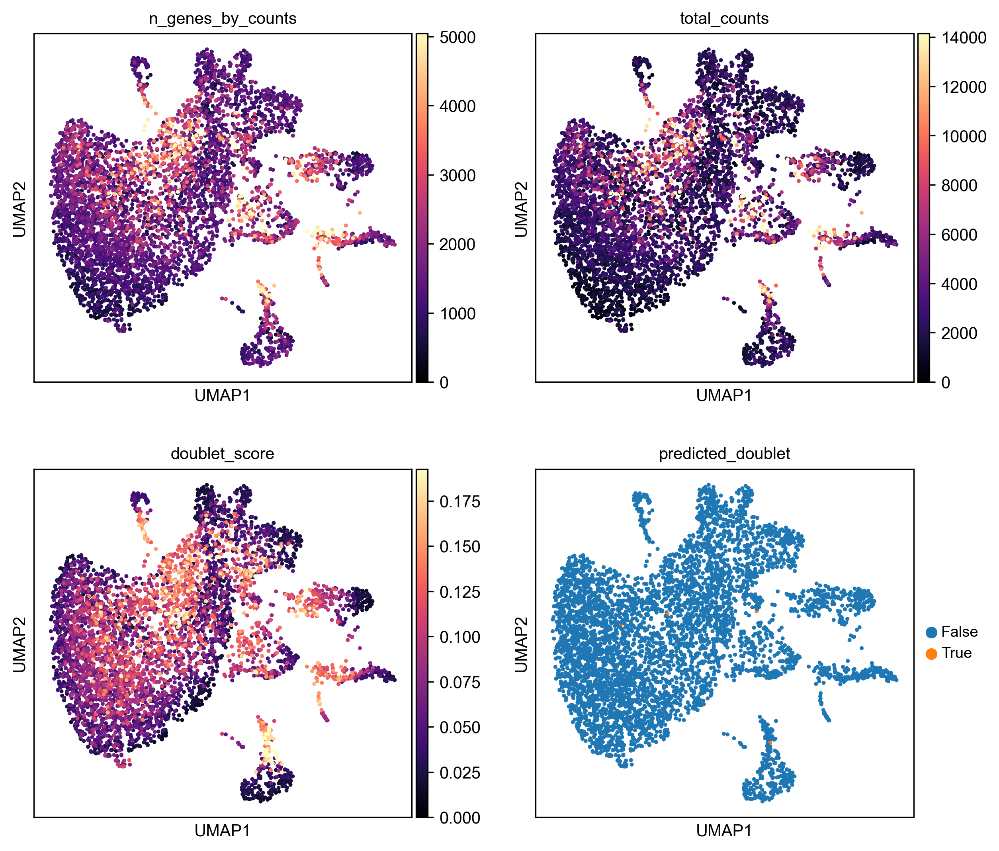

In [29]:
for key, adata in filtered_adata_dict.items():
    sc.pl.umap(adata, color=['n_genes_by_counts', 'total_counts', 'doublet_score', 'predicted_doublet'],
               cmap="magma", vmin=0, vmax="p99", 
               ncols=2,
               save=f'_{key}_doublets.svg'
              )
    print()

### 11) Based on all of the plots we've generated, do you think the samples had been filtered sufficiently? Have the likely doublets been identified? Would you do anything else at this point? Re-visit your quality control steps and change anything you deem fit. When you are done, subset the data to remove doublets, for example, by running the following for each sample

```adata = adata[adata.obs['doublet_info'] == False, :]```

P.S. remember to reset the counts matrix to unnormalised counts for each anndata object if you are planning to run Scrublet again by running 

```adata.X = adata.layers['counts'].copy()```

Processing CellRanger_DEV16569_Ach_Jan2023 (Object 1)
Running Scrublet
filtered out 29 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Detected doublet rate = 5.0%
Estimated detectable doublet fraction = 35.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 13.9%
    Scrublet finished (0:00:43)


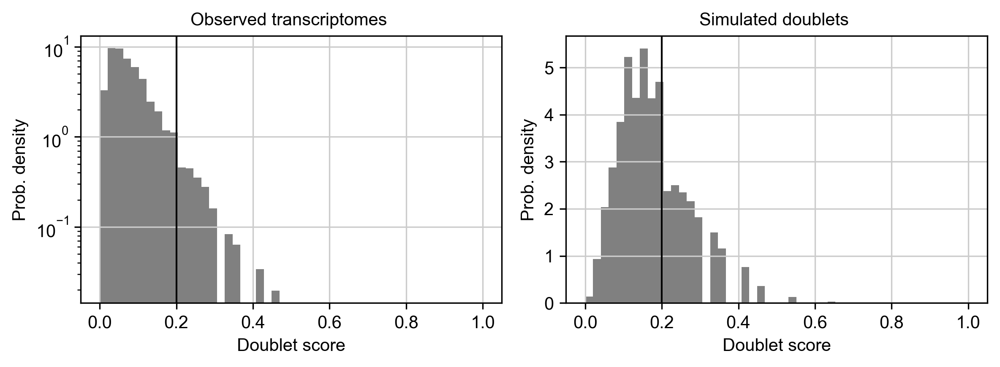

Processing CellRanger_DEV16127_Quad_Jan2023 (Object 2)
Running Scrublet
filtered out 276 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Detected doublet rate = 4.0%
Estimated detectable doublet fraction = 41.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 9.6%
    Scrublet finished (0:00:33)


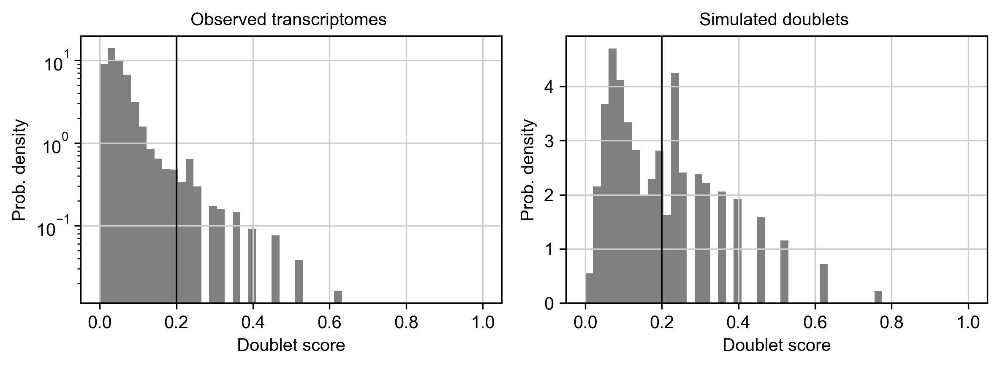

Processing CellRanger_DEV15984_Ach_Sep2022 (Object 3)
Running Scrublet
filtered out 322 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Detected doublet rate = 2.1%
Estimated detectable doublet fraction = 9.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 21.7%
    Scrublet finished (0:00:17)


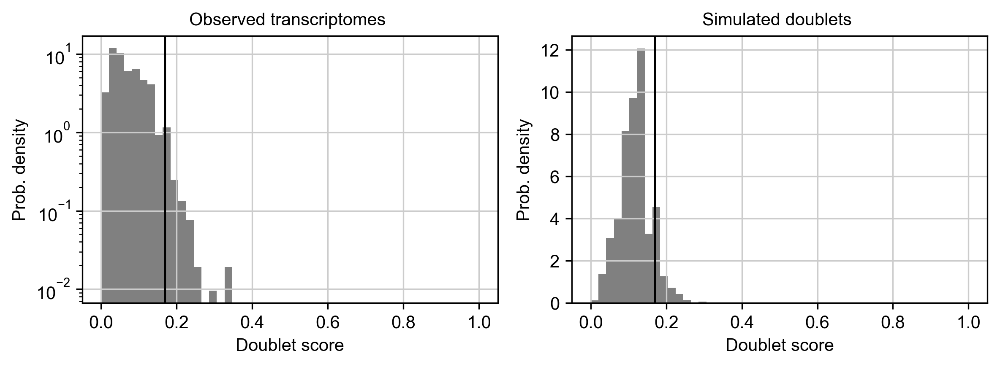

In [30]:
for i, (key, adata) in enumerate(filtered_adata_dict.items()):
    print(f"Processing {key} (Object {i+1})")
    
    adata.X = adata.layers['counts'].copy()
    
    if i == 0:
        sc.pp.scrublet(adata, expected_doublet_rate = 0.05, sim_doublet_ratio = 3, threshold=0.2)
        sc.pl.scrublet_score_distribution(adata)
    elif i == 1:
        sc.pp.scrublet(adata, expected_doublet_rate = 0.05, sim_doublet_ratio = 3, threshold=0.2)
        sc.pl.scrublet_score_distribution(adata)
    elif i == 2:
        sc.pp.scrublet(adata, expected_doublet_rate = 0.05, sim_doublet_ratio = 3, threshold=0.17)
        sc.pl.scrublet_score_distribution(adata)
    else:
        print('yo smth not right man')

In [31]:
filtered_adata_dict

{'CellRanger_DEV16569_Ach_Jan2023': AnnData object with n_obs × n_vars = 10039 × 23863
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'doublet_score', 'predicted_doublet'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
     uns: 'scrublet', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'predicted_doublet_colors'
     obsm: 'X_pca', 'X_umap'
     varm: 'PCs'
     layer

In [32]:
for key, adata in filtered_adata_dict.items():
    process_and_visualize(adata)

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=30


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:03)
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=30


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:06)
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=30


/opt/homebrew/Caskroom/miniforge/base/envs/scvitools/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:03)


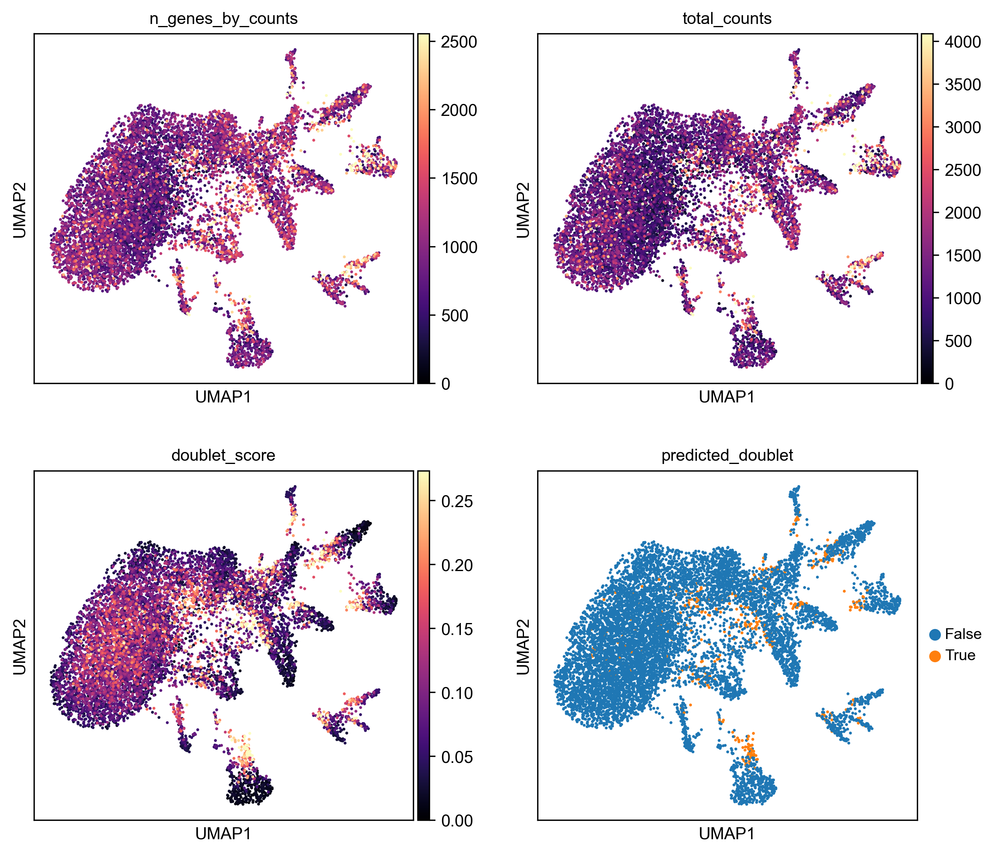

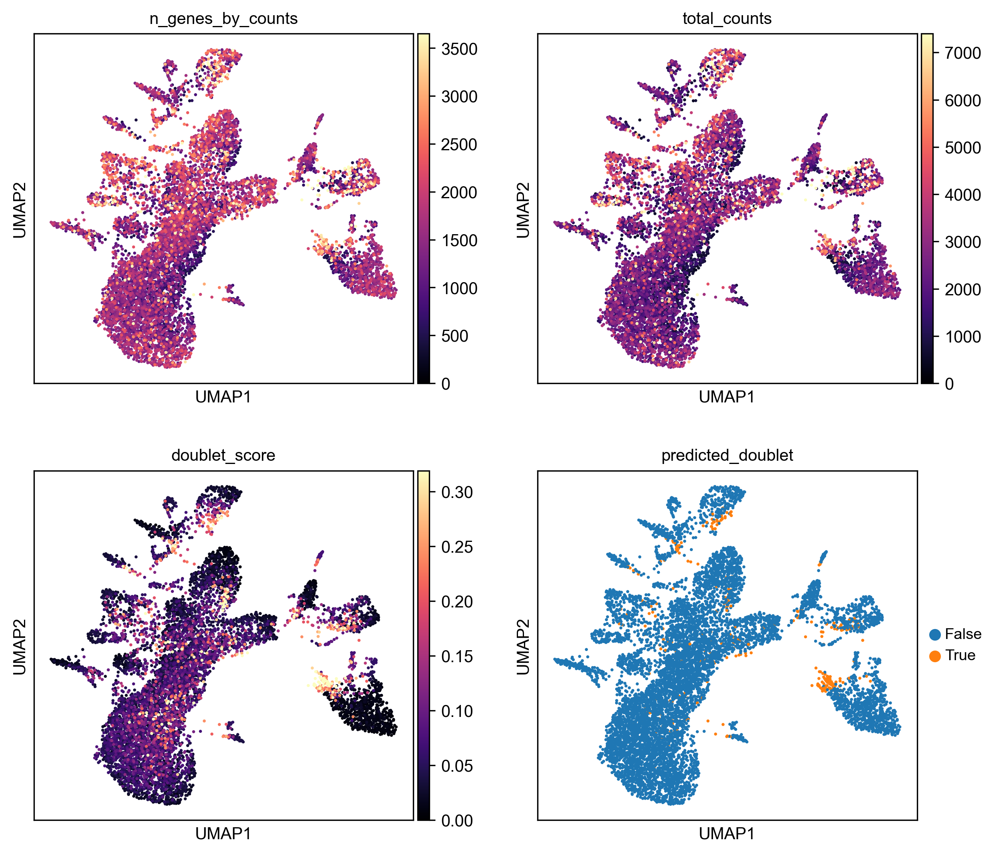

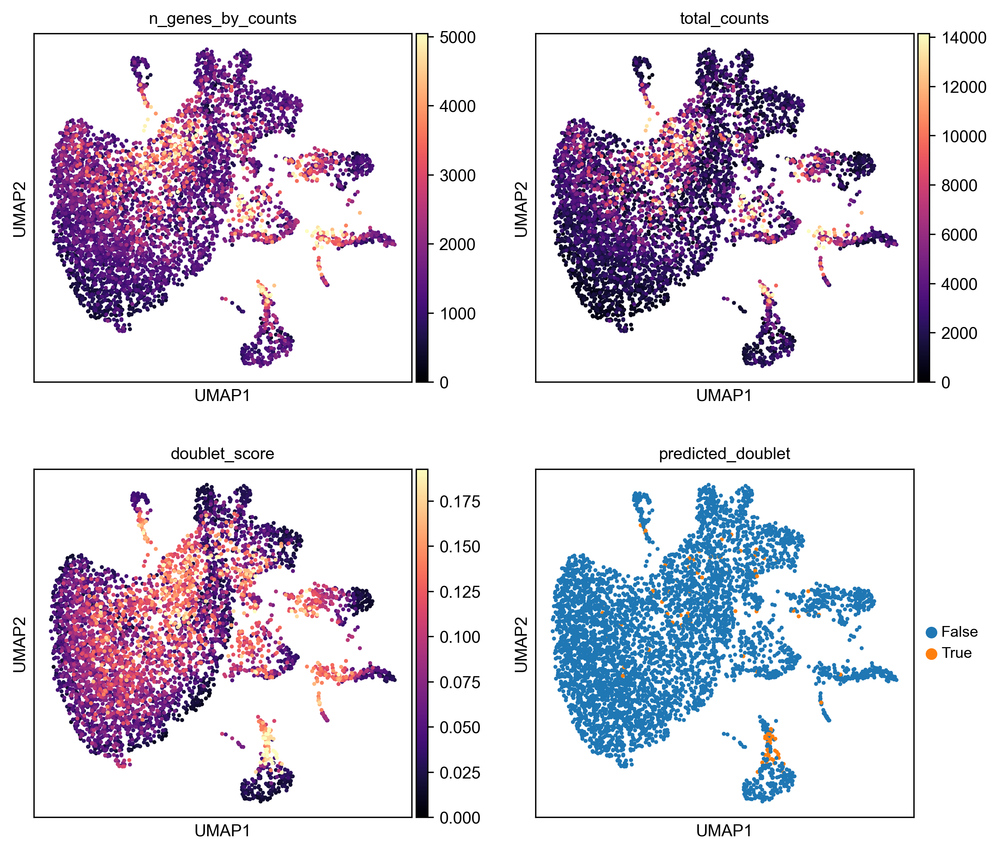

In [33]:
for key, adata in filtered_adata_dict.items():
    sc.pl.umap(adata, color=['n_genes_by_counts', 'total_counts', 'doublet_score', 'predicted_doublet'],
               cmap="magma", vmin=0, vmax="p99", 
               ncols=2,
               save=f'_{key}_doublets.svg'
              )
    print()

In [34]:
adata.obs['predicted_doublet'] 

CATAAGCTCCCAACTC.DEV15984_Ach    False
CGGGCATGTCGTTGCG.DEV15984_Ach    False
TGCGGGTTCGACGACC.DEV15984_Ach    False
TGCGGCACAATGACCT.DEV15984_Ach    False
CATCCCAAGTTAGAAC.DEV15984_Ach    False
                                 ...  
TGATGCAAGGGCGAAG.DEV15984_Ach    False
CCTAAGATCGGAATTC.DEV15984_Ach    False
ATCATTCGTCTTGAGT.DEV15984_Ach    False
GCAACATGTAAGATCA.DEV15984_Ach     True
GTTCCGTTCCCTAGGG.DEV15984_Ach    False
Name: predicted_doublet, Length: 5148, dtype: category
Categories (2, bool): [False, True]

In [35]:
for key, adata in filtered_adata_dict.items():
    filtered_adata_dict[key] = adata[adata.obs['predicted_doublet'] == False, :]
filtered_adata_dict

{'CellRanger_DEV16569_Ach_Jan2023': View of AnnData object with n_obs × n_vars = 9540 × 23863
     obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'doublet_score', 'predicted_doublet'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
     uns: 'scrublet', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'predicted_doublet_colors'
     obsm: 'X_pca', 'X_umap'
     varm: 'PCs'
   

### 12) Concatenate and save your filtered anndata object.

In [43]:
def concat_filtered_adatafiles(filtered_adata_dict):
    adata_list = list(filtered_adata_dict.values())
    
    # Concatenate the anndata objects
    adata_concat = anndata.concat(
        adata_list,
        join='outer',
        index_unique=None      # Optional: specify a custom index unique function
    )
    
    return adata_concat

In [ ]:
adata_concat = concat_filtered_adatafiles(filtered_adata_dict)
adata_concat

In [45]:
adata_concat.obs

,samplename,sex,age,donor,type,libbatch,barcode,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,...,log1p_total_counts_ribo,pct_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,outlier,mt_outlier,doublet_score,predicted_doublet,batch
AGGTTACTCTATCGTT.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,AGGTTACTCTATCGTT,9116,9115,9.117786,...,3.496508,0.060538,3,1.386294,0.005675,True,False,NaN,NaN,0
TCTGGCTCACGTACAT.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,TCTGGCTCACGTACAT,9607,9606,9.170247,...,3.761200,0.086191,3,1.386294,0.006156,True,True,NaN,NaN,0
CCCTCAAGTCATAACC.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,CCCTCAAGTCATAACC,8189,8188,9.010547,...,3.761200,0.084652,3,1.386294,0.006047,True,False,NaN,NaN,0
AATGACCCAACCTATG.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,AATGACCCAACCTATG,8613,8612,9.061028,...,3.367296,0.058759,5,1.791759,0.010493,True,False,NaN,NaN,0
GGTAATCCACTGGCCA.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,GGTAATCCACTGGCCA,8228,8227,9.015298,...,3.583519,0.074417,5,1.791759,0.010631,True,False,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CATCGGGTCGTCAAAC.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,CATCGGGTCGTCAAAC,358,357,5.880533,...,0.000000,0.000000,0,0.000000,0.000000,False,False,0.022591,False,3
TGATGCAAGGGCGAAG.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,TGATGCAAGGGCGAAG,339,338,5.826000,...,0.000000,0.000000,0,0.000000,0.000000,False,False,0.016337,False,3
CCTAAGATCGGAATTC.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,CCTAAGATCGGAATTC,374,373,5.924256,...,0.000000,0.000000,0,0.000000,0.000000,False,False,0.025217,False,3
ATCATTCGTCTTGAGT.DEV15984_Ach,CellRanger_DEV15984_Ach_Sep2022,male,40,DEV15984,Ach,Sep2022,ATCATTCGTCTTGAGT,383,382,5.948035,...,0.693147,0.237530,0,0.000000,0.000000,False,False,0.018195,False,3


In [ ]:
adata_concat.var

In [ ]:
adata_concat.write(os.path.join(RESULTS_FOLDERNAME, 'filtered_adata.h5ad'))